## setup

### install additional packages

In [85]:
# !pip install audiomentations # CPU (numpy) augmentations
# !pip install torch-audiomentations # GPU (torch) augmentations

### config

In [117]:
import torch
class BaseConfig:
    duration = 0.5
    sample_rate = 48000
    n_mels = 128
    n_fft = 2048
    hop_length = 172
    audio_len = int(duration*sample_rate)
    # hop_length = audio_len // (target_length-1)
    top_db = 40
    seed=42
    batch_size = 32
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    parent_to_dataset_klass_mapping = {
        "good-sound": ["good-sound"],
        "bad-dynamic-stability": [
            "bad-dynamics",
            "bad-dynamics-crescendo",
            "bad-dynamics-decrescendo",
            "bad-dynamics-errors",
            "bad-dynamics-tremolo"
        ],
        "bad-pitch-stability": [
            "bad-pitch",
            "bad-pitch-errors",
            "bad-pitch-vibrato"
        ],
        "bad-timbre-stability": [
            "bad-timbre",
            "bad-timbre-errors"
        ],
        "bad-timbre-richness": [
            "bad-richness",
            "bad-richness-bridge",
            "bad-richness-sultasto"
        ],
        "bad-attack-clarity": [
            "bad-attack",
            "bad-attack-pressure",
            "bad-attack-rebond"
        ]
    }
    num_classes = len(parent_to_dataset_klass_mapping)


class ColabConfig(BaseConfig):
    experiments_dir = "drive/MyDrive/logs/violin-good-sounds-classifier"
    dataset_dir = "/content/drive/My Drive/datasets/good-sounds-dataset-violin_single_notes"
    local_dataset_dir = "/content/dataset"
    processed_dataset_dir = "/content/dataset-processed"
    processed_dataset_dir_neumann = "/content/dataset-processed-neumann"
    processed_dataset_dir_akg = "/content/dataset-processed-akg"
    processed_dataset_dir_iphone = "/content/dataset-processed-iphone"
    output_base_path = dataset_dir.replace("violin_single_note_sound_files", "violin_single_note_sound_files_trimmed")

class LocalConfig(BaseConfig):
    experiments_dir = "logs"
    dataset_dir = "data/datasets/violin_single_note_sound_files"
    local_dataset_dir = dataset_dir # because we dont have to copy it from drive
    processed_dataset_dir = "data/dataset-processed"
    processed_dataset_dir_neumann = "data/dataset-processed-neumann"
    processed_dataset_dir_akg = "data/dataset-processed-akg"
    processed_dataset_dir_iphone = "data/dataset-processed-iphone"

    augmented_spectrograms_dir = "data/augmented_spectrograms"
    output_base_path = dataset_dir.replace("violin_single_note_sound_files", "violin_single_note_sound_files_trimmed")
def is_colab():
    try:
        import google.colab
        return True
    except ImportError:
        return False

Config = ColabConfig if is_colab() else LocalConfig

In [87]:
print(f"Using config: {Config.__name__}")
print(f"Experiments directory: {Config.experiments_dir}")
print(f"Dataset directory: {Config.dataset_dir}")
print(f"Local dataset directory: {Config.local_dataset_dir}")
print(f"Processed dataset directory: {Config.processed_dataset_dir}")
print(f"Processed dataset directory (Neumann): {Config.processed_dataset_dir_neumann}")
print(f"Processed dataset directory (AKG): {Config.processed_dataset_dir_akg}")
print(f"Processed dataset directory (iPhone): {Config.processed_dataset_dir_iphone}")

Using config: LocalConfig
Experiments directory: logs
Dataset directory: data/datasets/violin_single_note_sound_files
Local dataset directory: data/datasets/violin_single_note_sound_files
Processed dataset directory: data/dataset-processed
Processed dataset directory (Neumann): data/dataset-processed-neumann
Processed dataset directory (AKG): data/dataset-processed-akg
Processed dataset directory (iPhone): data/dataset-processed-iphone


### connect to drive (if on colab)

In [88]:
if is_colab():
    # Connect to Google Drive if running on Google Colab
    print("Connecting to Google Drive...")
    from google.colab import drive
    drive.mount("/content/drive", force_remount=True)

### copy files to local drive and unzip

In [89]:
import os
import zipfile

if is_colab():
    zip_file_path = Config.dataset_dir + '/violin_single_note_sound_files.zip'
    db_file_path = Config.dataset_dir + '/database.sqlite'
    local_destination = "/content/dataset"

    # Ensure the local destination directory exists
    if not os.path.exists(local_destination):
        os.makedirs(local_destination)
        print(f"Created directory: {local_destination}")

    # Copy the zip file and the database file
    !cp "{zip_file_path}" "{local_destination}/"
    !cp "{db_file_path}" "{local_destination}/"

    print(f"Copied '{zip_file_path}' to '{local_destination}/'")
    print(f"Copied '{db_file_path}' to '{local_destination}/'")

    # Unzip the file
    copied_zip_path = os.path.join(local_destination, 'violin_single_note_sound_files.zip')
    with zipfile.ZipFile(copied_zip_path, 'r') as zip_ref:
        zip_ref.extractall(local_destination)
        print(f"Unzipped '{copied_zip_path}' to '{local_destination}/'")

    # Delete the zip file
    os.remove(copied_zip_path)
    print(f"Deleted zip file: '{copied_zip_path}'")

### load data

In [90]:
import sqlite3
import pandas as pd
from sklearn.preprocessing import LabelEncoder

def load_data(db_path):
    """Loads data from the SQLite database into pandas DataFrames."""
    conn = sqlite3.connect(db_path)
    sounds_df = pd.read_sql_query("SELECT * FROM sounds", conn)
    takes_df = pd.read_sql_query("SELECT * FROM takes", conn)
    conn.close()
    return sounds_df, takes_df

def filter_violin_single_notes(sounds_df):
    """Filters the sounds DataFrame for violin single notes with good/bad labels."""
    filtered_df = sounds_df[
        (sounds_df['instrument'] == 'violin') &
        (sounds_df['klass'].notna()) &
        (sounds_df['klass'].str.contains("good-sound|bad", na=False)) &
        (~sounds_df['klass'].str.contains("scale", case=False, na=False))
    ].copy() # Use .copy() to avoid SettingWithCopyWarning
    return filtered_df

def filter_by_mic(df, mic_name):
    """Filters the DataFrame by the specified microphone name."""
    return df[df['microphone'] == mic_name].copy()

def merge_with_takes(sounds_df, takes_df):
    """Merges the filtered sounds DataFrame with the takes DataFrame."""
    merged_df = pd.merge(sounds_df, takes_df, left_on="id", right_on="sound_id")
    return merged_df

def map_klass_to_paper_label(klass, mapping):
    """Maps the dataset klass labels to parent paper labels."""
    for paper_label, dataset_klasses in mapping.items():
        if any(ds_klass in klass for ds_klass in dataset_klasses):
            return paper_label
    return "other"

def add_parent_label(df, mapping):
    """Adds a 'parent_label' column based on the klass column and mapping."""
    df['parent_label'] = df['klass'].apply(
        lambda x: map_klass_to_paper_label(x, mapping)
    )
    return df

def update_filenames(df, new_base_path):
    """Updates the filenames in the DataFrame."""
    df["filename"] = df["filename"].str.replace("sound_files/", "")
    df["filename"] = new_base_path + "/" + df["filename"]
    return df

def filter_and_encode_labels(df):
    """Filters the DataFrame and encodes the 'parent_label' column."""
    df_filtered = df[df['parent_label'] != 'Other'].copy()

    label_encoder = LabelEncoder()
    df_filtered["encoded_parent_label"] = label_encoder.fit_transform(
        df_filtered["parent_label"]
    )

    label_to_class = dict(zip(label_encoder.transform(label_encoder.classes_), label_encoder.classes_))
    print(label_to_class)

    return df_filtered, label_encoder, label_to_class

### get small subset of data

In [91]:
def get_subset_by_class(df, num_samples_per_class=None):
    """
    Gets a subset of a DataFrame with a specified number of samples per class.

    Args:
        df (pd.DataFrame): The input DataFrame with an 'encoded_parent_label' column.
        num_samples_per_class (dict or int, optional): If a dictionary,
            specifies the number of samples to select for each class, using the
            encoded label as the key. If an integer, selects this number of
            samples for each class. If None, returns the original DataFrame.
            Defaults to None.

    Returns:
        pd.DataFrame: The subset DataFrame.
    """
    if num_samples_per_class is None:
        return df

    subset_df = pd.DataFrame()
    if isinstance(num_samples_per_class, int):
      # Get unique classes if an integer is provided
      unique_classes = df['encoded_parent_label'].unique()
      class_sample_counts = {cls: num_samples_per_class for cls in unique_classes}
    elif isinstance(num_samples_per_class, dict):
      class_sample_counts = num_samples_per_class
    else:
      raise ValueError("num_samples_per_class must be an int or a dictionary")


    for class_label, num_samples in class_sample_counts.items():
        class_subset = df[df['encoded_parent_label'] == class_label].sample(
            n=min(num_samples, len(df[df['encoded_parent_label'] == class_label])),
            random_state=42 # for reproducibility
        )
        subset_df = pd.concat([subset_df, class_subset], ignore_index=True)

    return subset_df

### audio level pre-processing

In [92]:
from tqdm import tqdm
import os
from audiomentations import Trim
import torch
import torchaudio

def chunk_audio(waveform):
    """
    Return a list of chunks of the audio. Padding if needed. 0.5s chunks (Config.audio_len samples).
    """
    chunk_size = Config.audio_len
    num_channels, num_samples = waveform.shape

    # Calculate how many chunks we need
    num_chunks = (num_samples + chunk_size - 1) // chunk_size  # ceil division

    # Pad the waveform to fit the total number of chunks
    padded_len = num_chunks * chunk_size
    if padded_len > num_samples:
        pad_amount = padded_len - num_samples
        pad_tensor = torch.zeros((num_channels, pad_amount))
        waveform = torch.cat((waveform, pad_tensor), dim=1)

    # Split into chunks
    chunks = []
    for i in range(num_chunks):
        start = i * chunk_size
        end = start + chunk_size
        chunk = waveform[:, start:end]
        chunks.append(chunk)

    return chunks

def preprocess_audio(df, output_dir=Config.processed_dataset_dir):
    """
    Trim silence and chop audio into 0.5s chunks. Save each chunk as a file.
    Also save metadata for each chunk.
    """
    trim_transform = Trim(
        top_db=Config.top_db,
        p=1.0
    )

    os.makedirs(output_dir, exist_ok=True)

    chunk_metadata = []  # list of dicts

    for index, row in tqdm(df.iterrows(), total=len(df)):
        audio_filepath = row['filename']
        label = row['parent_label']

        # Extract folder names for naming
        mic_dir = os.path.basename(os.path.dirname(audio_filepath))  # e.g., "akg"
        instrument_player_dir = os.path.basename(os.path.dirname(os.path.dirname(audio_filepath)))  # e.g., "violin_playername"
        base_name = os.path.splitext(os.path.basename(audio_filepath))[0]
        name_prefix = f"{instrument_player_dir}_{mic_dir}_{base_name}"

        audio, sample_rate = torchaudio.load(audio_filepath)

        if sample_rate != Config.sample_rate:
            raise ValueError(f"Sample rate of {audio_filepath} is not {Config.sample_rate}")

        trimmed_audio = trim_transform(audio, Config.sample_rate)

        if label == 'bad-attack':
            # Save just the first 0.5s
            chunk = trimmed_audio[:, :Config.audio_len]
            chunk_name = f"{name_prefix}_chunk0.wav"
            chunk_path = os.path.join(output_dir, chunk_name)
            torchaudio.save(chunk_path, chunk, sample_rate)

            # Save metadata
            chunk_row = row.to_dict()
            chunk_row['chunk_filename'] = chunk_path
            chunk_row['parent_filename'] = audio_filepath
            chunk_metadata.append(chunk_row)

        else:
            chunks = chunk_audio(trimmed_audio)
            for i, chunk in enumerate(chunks):
                chunk_name = f"{name_prefix}_chunk{i}.wav"
                chunk_path = os.path.join(output_dir, chunk_name)
                torchaudio.save(chunk_path, chunk, sample_rate)

                # Save metadata
                chunk_row = row.to_dict()
                chunk_row['chunk_filename'] = chunk_path
                chunk_row['parent_filename'] = audio_filepath
                chunk_metadata.append(chunk_row)


    # Convert metadata to DataFrame and save to CSV
    chunk_df = pd.DataFrame(chunk_metadata)
    chunk_df.to_csv(os.path.join(output_dir, "processed_metadata.csv"), index=False)
    return chunk_df

def preprocess_if_needed(df, output_dir):
    metadata_path = os.path.join(output_dir, "processed_metadata.csv")
    if os.path.exists(metadata_path):
        print(f"Found existing processed metadata at {metadata_path}, loading...")
        return pd.read_csv(metadata_path)
    else:
        print(f"No processed metadata found at {metadata_path}, running preprocessing...")
        return preprocess_audio(df, output_dir=output_dir)

### load the dataset-processed wav files and check whether they are all the same length exactly

In [93]:
import glob

def check_audio_lengths(processed_dir):
    """
    Loads all processed WAV files and checks if they have the same number of samples.

    Args:
        processed_dir (str): The directory containing the processed WAV files.

    Returns:
        bool: True if all files have the same length, False otherwise.
        int or None: The common length if all files have the same length,
                     otherwise None.
        list: A list of tuples (filename, length) for all files.
    """
    wav_files = glob.glob(os.path.join(processed_dir, '*.wav'))
    if not wav_files:
        print("No WAV files found in the processed directory.")
        return True, None, []

    file_lengths = []
    for audio_path in tqdm(wav_files, desc="Checking audio lengths"):
        try:
            # Get audio information without loading the whole waveform
            info = torchaudio.info(audio_path)
            num_frames = info.num_frames
            file_lengths.append((audio_path, num_frames))
        except Exception as e:
            print(f"Error processing file {audio_path}: {e}")
            file_lengths.append((audio_path, None)) # Indicate error

    if not file_lengths:
        return True, None, [] # No files processed successfully

    # Check if all processed files have the same length
    first_length = None
    if file_lengths[0][1] is not None:
        first_length = file_lengths[0][1]
        all_same_length = all(length == first_length for _, length in file_lengths if length is not None)
    else:
         # If the first file had an error, check the next valid one
         valid_lengths = [length for _, length in file_lengths if length is not None]
         if not valid_lengths:
             print("No valid audio files found to check lengths.")
             return True, None, file_lengths # Consider it 'same' if no valid files
         first_length = valid_lengths[0]
         all_same_length = all(length == first_length for length in valid_lengths)


    return all_same_length, first_length, file_lengths

# Example usage after running preprocess_audio:
processed_dir = Config.processed_dataset_dir
all_same, common_length, file_lengths_list = check_audio_lengths(processed_dir)

if all_same:
    print(f"All processed audio files have the same length: {common_length} frames.")
else:
    print("Processed audio files have different lengths.")
    print("File lengths:")
    for filename, length in file_lengths_list:
        print(f"- {filename}: {length} frames")

No WAV files found in the processed directory.
All processed audio files have the same length: None frames.


### models

In [94]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SimpleCNN(nn.Module):
    def __init__(self, num_classes):
        super(SimpleCNN, self).__init__()
        # Input shape: (Batch, 1, n_mels, target_spectrogram_width) e.g., (Batch, 1, 128, 128)
        self.conv1 = nn.Conv2d(in_channels=1, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(16) # Add Batch Normalization
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2) # Output shape: (Batch, 16, 64, 64) assuming 128x128 input

        self.conv2 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(32) # Add Batch Normalization
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2) # Output shape: (Batch, 32, 32, 32)

        self.conv3 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm2d(64) # Add Batch Normalization
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2) # Output shape: (Batch, 64, 16, 16)

        self.conv4 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1)
        self.bn4 = nn.BatchNorm2d(128) # Add Batch Normalization
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2) # Output shape: (Batch, 128, 8, 8)

        self._to_linear = 128 * 8 * 8 # This needs to match the actual output size

        self.fc1 = nn.Linear(self._to_linear, 512)
        self.dropout = nn.Dropout(0.5) # Add dropout for regularization
        self.fc2 = nn.Linear(512, num_classes)

    def forward(self, x):
        x = self.pool1(F.relu(self.bn1(self.conv1(x))))
        x = self.pool2(F.relu(self.bn2(self.conv2(x))))
        x = self.pool3(F.relu(self.bn3(self.conv3(x))))
        x = self.pool4(F.relu(self.bn4(self.conv4(x))))

        # Flatten the output for the fully connected layers
        x = x.view(-1, self._to_linear) # -1 means infer batch size

        x = F.relu(self.fc1(x))
        x = self.dropout(x) # Apply dropout
        x = self.fc2(x) # No activation here, CrossEntropyLoss expects raw scores

        return x

### define dataset

In [95]:
import torch
import torchaudio
import torchaudio.transforms as T
from torch.utils.data import Dataset
from audiomentations import Compose, AddGaussianNoise, TimeStretch, PitchShift, Shift
import pandas as pd
import os
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split

class AudioChunkDataset(Dataset):
    def __init__(self, df, augment=False, augmentations=None):
        self.df = df.reset_index(drop=True)
        self.sample_rate = Config.sample_rate
        self.audio_len = Config.audio_len
        self.n_mels = Config.n_mels
        self.target_width = 128
        self.n_fft = Config.n_fft
        self.hop_length = Config.hop_length
        self.augment = augment

        if augmentations == None:
            self.augmenter = Compose([
                AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.5),
            ])
        else:
            self.augmenter = augmentations
        # # Define augmentations (audiomentations or torch_audiomentations)
        # self.augmenter = Compose([
        #     AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.5),
        # ])

        self.mel_transform = T.MelSpectrogram(
            sample_rate=self.sample_rate,
            n_fft=self.n_fft,
            hop_length=self.hop_length,
            n_mels=Config.n_mels,
            power=2.0,
            center=False,
        )

        self.amplitude_to_db = T.AmplitudeToDB()

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        file_path = row['chunk_filename']
        label = row['encoded_parent_label']

        waveform, sr = torchaudio.load(file_path)
        assert sr == self.sample_rate, f"Expected {self.sample_rate}, got {sr}"

        if self.augment:
            waveform = self._apply_augmentations(waveform)

        # If stereo (2 channels), convert to mono
        if waveform.shape[0] > 1:
            waveform = torch.mean(waveform, dim=0, keepdim=True)  # now [1, samples]

        # Mel spectrogram
        mel = self.mel_transform(waveform)
        mel_db = self.amplitude_to_db(mel)

        # normalize bits
        mean = torch.mean(mel_db, dim=[1, 2], keepdim=True)
        std = torch.std(mel_db, dim=[1, 2], keepdim=True)
        # Avoid division by zero
        mel_db = (mel_db - mean) / (std + 1e-6)

        # Resize to (1, 128, 128), shouldnt need this since all the samples are the same length exactly
        # mel_db = self._resize_mel(mel_db)

        return mel_db, label

    def _apply_augmentations(self, waveform):
        # audiomentations expects (samples,) np.array — use first channel
        waveform_np = waveform[0].numpy()
        augmented = self.augmenter(samples=waveform_np, sample_rate=self.sample_rate)
        return torch.tensor(augmented).unsqueeze(0)

    def _resize_mel(self, mel):
        # mel: shape (1, n_mels, time_steps)
        time_dim = mel.shape[-1]
        if time_dim < self.target_width:
            # pad
            pad_amt = self.target_width - time_dim
            mel = F.pad(mel, (0, pad_amt))
        elif time_dim > self.target_width:
            # crop
            mel = mel[..., :self.target_width]
        return mel

### define pregenerated dataset

In [96]:
import torch
from torch.utils.data import Dataset
import pandas as pd
import os

class PregeneratedMelDataset(Dataset):
    def __init__(self, df):
        self.df = df.reset_index(drop=True)

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        mel_file_path = row['pregenerated_mel_path']
        label = row['encoded_parent_label']

        # Load the pre-generated Mel spectrogram tensor
        mel_spec = torch.load(mel_file_path)

        # Ensure the shape is (1, n_mels, time_steps) - should be (1, 128, 128) if pregenerated correctly
        # The normalization should have been done during pregeneration
        # assert mel_spec.shape[0] == 1, f"Expected channel dim 1, got {mel_spec.shape[0]} for {mel_file_path}"
        # assert mel_spec.shape[1] == Config.n_mels, f"Expected n_mels {Config.n_mels}, got {mel_spec.shape[1]} for {mel_file_path}"
        # assert mel_spec.shape[2] == 128, f"Expected time_steps 128, got {mel_spec.shape[2]} for {mel_file_path}"


        return mel_spec, label

### pregenerate augmented mels. (function: save all augmented data before train time)

In [111]:
import torch
import torchaudio
import torchaudio.transforms as T
import os
import pandas as pd
from tqdm import tqdm
from audiomentations import Compose, AddGaussianNoise, Gain, Shift, HighPassFilter, LowPassFilter
import json

def pregenerate_augmented_mels(
    df,
    output_base_dir,
    num_augmentations_per_sample=1,
    augmentations=None,
    seed=42, # for reproducibility of augmentations
    disable_augmentations=False, # New parameter to disable augmentations
    save_originals=True # New parameter to save original mel spectrograms
):
    """
    Pre-generates augmented audio chunks and saves their Mel spectrograms to disk.

    Args:
        df (pd.DataFrame): DataFrame containing metadata for original audio chunks
                           (including 'chunk_filename' and 'encoded_parent_label').
        output_base_dir (str): The base directory to save the pre-generated data.
                               Subdirectories will be created for each augmentation.
        num_augmentations_per_sample (int): The number of augmented versions to
                                            create for each original chunk. Ignored
                                            if disable_augmentations is True.
        augmentations (audiomentations.Compose): A Compose object defining the
                                                 augmentations to apply. If None,
                                                 a default Gaussian noise augmentation
                                                 will be used. Ignored if
                                                 disable_augmentations is True.
        seed (int): Random seed for reproducibility of augmentations.
        disable_augmentations (bool): If True, only the original mel spectrograms
                                      are generated and saved.
    Returns:
        pd.DataFrame: A DataFrame containing metadata for the pre-generated mel
                      spectrogram files.
    """
    if augmentations is None and not disable_augmentations:
        augmentations = Compose([
            AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=1.0), # Apply to all
        ])

    os.makedirs(output_base_dir, exist_ok=True)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    mel_transform = T.MelSpectrogram(
        sample_rate=Config.sample_rate,
        n_fft=Config.n_fft,
        hop_length=Config.hop_length,
        n_mels=Config.n_mels,
        power=2.0,
        center=False,
    ).to(device)

    amplitude_to_db = T.AmplitudeToDB().to(device)

    pregenerated_metadata = []

    # Use a separate random state for augmentations for reproducibility
    # audiomentations uses numpy random state
    # Ensure consistent random state for augmentations
    import numpy as np
    np.random.seed(seed)


    for index, row in tqdm(df.iterrows(), total=len(df), desc="Pregenerating augmented mels"):
        original_chunk_path = row['chunk_filename']
        label = row['encoded_parent_label']
        parent_label = row['parent_label']

        try:
            waveform, sr = torchaudio.load(original_chunk_path)
            assert sr == Config.sample_rate, f"Expected {Config.sample_rate}, got {sr} for {original_chunk_path}"

            # If stereo (2 channels), convert to mono
            if waveform.shape[0] > 1:
                waveform = torch.mean(waveform, dim=0, keepdim=True)

            # Ensure waveform is the correct length (should be handled by preprocess_audio, but double check)
            if waveform.shape[1] != Config.audio_len:
                 # This should not happen if preprocess_audio works correctly
                 print(f"Warning: {original_chunk_path} has unexpected length {waveform.shape[1]}")
                 # Optionally pad/trim here if necessary, but ideally fix in preprocess_audio

            if save_originals:
                # Always process the original (non-augmented) version
                waveform = waveform.to(device)
                mel_original = mel_transform(waveform)
                mel_db_original = amplitude_to_db(mel_original)

                # Normalize
                mean = torch.mean(mel_db_original, dim=[1, 2], keepdim=True)
                std = torch.std(mel_db_original, dim=[1, 2], keepdim=True)
                mel_db_original = (mel_db_original - mean) / (std + 1e-6)

            
                # Save original mel spec
                original_mel_filename = os.path.basename(original_chunk_path).replace(".wav", "_original.pt")
                original_mel_path = os.path.join(output_base_dir, original_mel_filename)
                torch.save(mel_db_original.cpu(), original_mel_path)

                # Add metadata for original
                metadata_row_original = row.to_dict()
                metadata_row_original['pregenerated_mel_path'] = original_mel_path
                metadata_row_original['augmentation_type'] = 'original'
                pregenerated_metadata.append(metadata_row_original)

            # Generate and save augmented versions if not disabled
            if not disable_augmentations:
                for i in range(num_augmentations_per_sample):
                    # audiomentations expects (samples,) np.array — use first channel
                    waveform_np = waveform[0].numpy()
                    # Apply augmentations
                    augmented_np = augmentations(samples=waveform_np, sample_rate=Config.sample_rate)

                    augmented_waveform = torch.tensor(augmented_np).unsqueeze(0) # Add channel dim

                    # Compute Mel spectrogram for augmented audio
                    mel_augmented = mel_transform(augmented_waveform)
                    mel_db_augmented = amplitude_to_db(mel_augmented)

                    # Normalize
                    mean_aug = torch.mean(mel_db_augmented, dim=[1, 2], keepdim=True)
                    std_aug = torch.std(mel_db_augmented, dim=[1, 2], keepdim=True)
                    mel_db_augmented = (mel_db_augmented - mean_aug) / (std_aug + 1e-6)

                    # Save augmented mel spec
                    augmented_mel_filename = os.path.basename(original_chunk_path).replace(".wav", f"_aug{i+1}.pt")
                    augmented_mel_path = os.path.join(output_base_dir, augmented_mel_filename)
                    # torch.save(mel_db_augmented, augmented_mel_path)
                    torch.save(mel_db_augmented.cpu(), augmented_mel_path)

                    # Add metadata for augmented version
                    metadata_row_augmented = row.to_dict()
                    metadata_row_augmented['pregenerated_mel_path'] = augmented_mel_path
                    metadata_row_augmented['augmentation_type'] = f'augmentation_{i+1}'
                    pregenerated_metadata.append(metadata_row_augmented)

        except Exception as e:
            print(f"Error processing audio chunk {original_chunk_path}: {e}")
            # Optionally log the error and skip this chunk

    # Convert metadata to DataFrame and save to CSV
    pregenerated_df = pd.DataFrame(pregenerated_metadata)
    pregenerated_df.to_csv(os.path.join(output_base_dir, "pregenerated_metadata.csv"), index=False)
    return pregenerated_df

### mic augment

### define train loop

In [98]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import os

from torch.utils.tensorboard import SummaryWriter


def evaluate(model, data_loader, criterion, device='cuda'):
    model.eval()
    total_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, labels)

            total_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

    avg_loss = total_loss / total
    accuracy = correct / total
    return avg_loss, accuracy


def write_train_data(epoch, train_loss, train_acc, val_loss, val_acc, writer, csv="train_log"):
    writer.add_scalar("Loss/Train", train_loss, epoch)
    writer.add_scalar("Accuracy/Train", train_acc, epoch)

    writer.add_scalar("Loss/Validation", val_loss, epoch)
    writer.add_scalar("Accuracy/Validation", val_acc, epoch)

    # lets now also write this to a csv so we can plot it later
    with open(csv, 'a') as f:
        f.write(f"{epoch},{train_loss},{train_acc},{val_loss},{val_acc}\n")

def plot_train_data(csv="train_log"):
    df = pd.read_csv(csv, names=["epoch", "train_loss", "train_acc", "val_loss", "val_acc"])
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(df["epoch"], df["train_loss"], label="Train Loss")
    plt.plot(df["epoch"], df["val_loss"], label="Validation Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.plot(df["epoch"], df["train_acc"], label="Train Accuracy")
    plt.plot(df["epoch"], df["val_acc"], label="Validation Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.show()
    return df


def train_model(model, train_loader, val_loader, num_epochs, lr, device='cuda', save_path=None, log_dir="./runs/train_logs", name="model"):
    print("Training model with ", device)

    writer = SummaryWriter(log_dir=log_dir)

    model = model.to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)

    best_val_acc = 0.0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

        train_loss = running_loss / total
        train_acc = correct / total

        val_loss, val_acc = evaluate(model, val_loader, criterion, device)

        write_train_data(epoch, train_loss, train_acc, val_loss, val_acc, writer)

        # writer.add_scalar("Loss/Train", train_loss, epoch)
        # writer.add_scalar("Accuracy/Train", train_acc, epoch)

        # writer.add_scalar("Loss/Validation", val_loss, epoch)
        # writer.add_scalar("Accuracy/Validation", val_acc, epoch)

        print(f"Train Loss: {train_loss:.4f}, Acc: {train_acc:.4f} | Val Loss: {val_loss:.4f}, Acc: {val_acc:.4f}")

        # Save best model
        if save_path and val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save(model.state_dict(), save_path)
            print(f"Saved model with val acc: {val_acc:.4f}")

    print("\nTraining complete.")

### define pregenerated train loop

In [99]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import os
import pandas as pd # Import pandas for plot_train_data

from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt # Import matplotlib for plotting


def evaluate_pregenerated(model, data_loader, criterion, device='cuda'):
    model.eval()
    total_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, labels)

            total_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

    avg_loss = total_loss / total
    accuracy = correct / total
    return avg_loss, accuracy


def train_model_pregenerated(
            model,
            train_loader,
            val_loader,
            params, #{experiment_name, batch_size, num_epochs, lr}
            device='cuda',
            save=True,
            log_dir="drive/MyDrive/logs/violin-good-sounds-classifier",
        ):
    print("Training pregenerated model with ", device)

    experiment_name, batch_size, num_epochs, lr = params.values()

    exp_string = f"{experiment_name}_bs:{batch_size}_ep:{num_epochs}_lr:{lr}"

    # if it already exists abort, we need a unique experiment name
    # if os.path.exists(exp_dir):
    #     print(f"Experiment {experiment_name} already exists with dir: {exp_dir}")
    #     return

    exp_dir = os.path.join(log_dir, experiment_name)
    if not os.path.exists(exp_dir):
        os.makedirs(exp_dir)
        print(f"Created log directory: {exp_dir}")

    writer = SummaryWriter(log_dir=exp_dir)

    model = model.to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)

    best_val_acc = 0.0

    # Create or clear the log CSV file
    csv_path = os.path.join(exp_dir, f"{experiment_name}_train_log.csv")
    with open(csv_path, 'w') as f:
        f.write("epoch,train_loss,train_acc,val_loss,val_acc\n")


    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

        train_loss = running_loss / total
        train_acc = correct / total

        val_loss, val_acc = evaluate_pregenerated(model, val_loader, criterion, device)

        # write_train_data(epoch, train_loss, train_acc, val_loss, val_acc, writer) # Use the new csv path
        with open(csv_path, 'a') as f:
            f.write(f"{epoch},{train_loss},{train_acc},{val_loss},{val_acc}\n")

        writer.add_scalar("Loss/Train", train_loss, epoch)
        writer.add_scalar("Accuracy/Train", train_acc, epoch)

        writer.add_scalar("Loss/Validation", val_loss, epoch)
        writer.add_scalar("Accuracy/Validation", val_acc, epoch)

        print(f"Train Loss: {train_loss:.4f}, Acc: {train_acc:.4f} | Val Loss: {val_loss:.4f}, Acc: {val_acc:.4f}")

        # Save best model
        # if save and val_acc > best_val_acc:
        #     best_val_acc = val_acc
        #     torch.save(model.state_dict(), exp_dir)
        #     print(f"Saved model with val acc: {val_acc:.4f}")
        if save and val_acc > best_val_acc:
            best_val_acc = val_acc
            model_path = os.path.join(exp_dir, f"{experiment_name}_best_model.pth")
            torch.save(model.state_dict(), model_path)
            print(f"Saved model with val acc: {val_acc:.4f}")


    print("\nSaving training params as json")
    with open(os.path.join(exp_dir, f"{exp_string}_params.json"), 'w') as f:
        json.dump(params, f)

    print("\nTraining complete.")
    writer.close() # Close the SummaryWriter

# utils for training and testing later
def get_best_model_path(train_params):
    experiment_name = train_params['experiment_name']
    model_save_path = os.path.join(Config.experiments_dir, experiment_name, f'{experiment_name}_best_model.pth')
    return model_save_path

### load pre-generated augmented data

In [110]:
import os

def load_augmented_data(config, augmented_base_dir, batch_size=32):
	"""
	Loads augmented data for train and test splits according to a config dict.
	Config example:
		{
			"train": [
				{"mic": "neumann", "aug": "gain_light"},
				{"mic": "akg", "aug": "gain_medium"}
			],
			"test": [
				{"mic": "iphone", "aug": "none"}
			]
		}
	Returns train_loader, test_loader, train_df, test_df
	"""

	def load_metadata(mic, aug):
		meta_path = os.path.join(augmented_base_dir, mic, aug, "pregenerated_metadata.csv")
		if not os.path.exists(meta_path):
			raise FileNotFoundError(f"Metadata not found: {meta_path}")
		return pd.read_csv(meta_path)

	# Load and concatenate train dataframes
	train_dfs = []
	for item in config["train"]:
		df = load_metadata(item["mic"], item["aug"])
		train_dfs.append(df)
	train_df = pd.concat(train_dfs, ignore_index=True)

	# Load and concatenate test dataframes
	test_dfs = []
	for item in config["test"]:
		df = load_metadata(item["mic"], item["aug"])
		test_dfs.append(df)
	test_df = pd.concat(test_dfs, ignore_index=True)

	# Create datasets and loaders
	train_dataset = PregeneratedMelDataset(train_df)
	test_dataset = PregeneratedMelDataset(test_df)
	train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
	test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

	return train_loader, test_loader, train_df, test_df

### train model old method test

In [100]:
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import os
from torch.utils.tensorboard import SummaryWriter

def train_model_old(model, train_dataloader, val_dataloader, train_dataset, val_dataset, device,
                num_epochs=10, lr=0.001, model_save_path=None, log_dir="./runs/train_logs"):

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)
    writer = SummaryWriter(log_dir=log_dir)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct_predictions = 0
        total_predictions = 0

        print(f"Epoch {epoch+1}/{num_epochs}")
        for inputs, labels in tqdm(train_dataloader, desc="Training Batches"):
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs.data, 1)
            total_predictions += labels.size(0)
            correct_predictions += (predicted == labels).sum().item()

        epoch_loss = running_loss / len(train_dataset)
        epoch_accuracy = correct_predictions / total_predictions
        print(f"Train Loss: {epoch_loss:.4f}, Train Accuracy: {epoch_accuracy:.4f}")

        writer.add_scalar("Loss/Train", epoch_loss, epoch)
        writer.add_scalar("Accuracy/Train", epoch_accuracy, epoch)

        model.eval()
        val_loss = 0.0
        correct_predictions = 0
        total_predictions = 0

        with torch.no_grad():
            for inputs, labels in tqdm(val_dataloader, desc="Validation Batches"):
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)

                val_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs.data, 1)
                total_predictions += labels.size(0)
                correct_predictions += (predicted == labels).sum().item()

        val_epoch_loss = val_loss / len(val_dataset)
        val_epoch_accuracy = correct_predictions / total_predictions
        print(f"Validation Loss: {val_epoch_loss:.4f}, Validation Accuracy: {val_epoch_accuracy:.4f}")

        writer.add_scalar("Loss/Validation", val_epoch_loss, epoch)
        writer.add_scalar("Accuracy/Validation", val_epoch_accuracy, epoch)

    print("Training finished.")
    writer.close()

    if model_save_path:
        try:
            os.makedirs(os.path.dirname(model_save_path), exist_ok=True)
            torch.save(model.state_dict(), model_save_path)
            print(f"Model saved to {model_save_path}")
        except Exception as e:
            print(f"Error saving model: {e}")

### code for displaying class numbers

In [101]:
from collections import Counter

def display_class_distribution(df):
    class_counts = df['parent_label'].value_counts()

    # Print the counts
    print("\nDistribution of 'parent_label' in the chunked dataset:")
    print(class_counts)

    # Plot the distribution
    plt.figure(figsize=(12, 7))
    class_counts.plot(kind='bar')
    plt.title('Distribution of Parent Labels in Processed Audio Chunks')
    plt.xlabel('Parent Label')
    plt.ylabel('Number of Chunks')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout() # Adjust layout to prevent labels overlapping
    plt.show()

### copy and/or resample the impulse response files.

In [108]:
import os
import torchaudio
import shutil

def copy_or_resample_to_48000hz(src_dir, dst_dir):
    """
    Copies impulse response audio files to dst_dir. If a file's sample rate is not 48000 Hz,
    it is resampled to 48000 Hz before saving. Reports the number of resampled files.
    """
    os.makedirs(dst_dir, exist_ok=True)
    total_files = 0
    resampled_files = 0

    for fname in os.listdir(src_dir):
        fpath = os.path.join(src_dir, fname)
        if not os.path.isfile(fpath):
            continue

        try:
            waveform, sample_rate = torchaudio.load(fpath)
            total_files += 1

            if sample_rate != 48000:
                resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=48000)
                waveform = resampler(waveform)
                resampled_files += 1

            out_path = os.path.join(dst_dir, fname)
            torchaudio.save(out_path, waveform, 48000)

        except Exception as e:
            print(f"Error processing {fname}: {e}")

    print(f"Total files processed: {total_files}")
    print(f"Resampled to 48000 Hz: {resampled_files}")
    print(f"Already at 48000 Hz: {total_files - resampled_files}")


### load experiment best model

In [118]:
def load_best_model(experiment_name):
		"""
		Loads the best model for a given experiment name.
		Assumes the model is saved in Config.experiments_dir/<experiment_name>/<experiment_name>_best_model.pth
		"""
		model_save_path = os.path.join(Config.experiments_dir, experiment_name, f"{experiment_name}_best_model.pth")
		if not os.path.exists(model_save_path):
				raise FileNotFoundError(f"Best model not found at {model_save_path}")

		model = SimpleCNN(num_classes=Config.num_classes)  # Adjust num_classes as needed
		model.load_state_dict(torch.load(model_save_path))
		model.eval()  # Set to evaluation mode
		return model

## Call methods

### Use all Mic data without augmentations and initial training tests.

### > put all data in dframe

In [102]:
db_path = Config.local_dataset_dir + '/database.sqlite' # dataset_dir + '/database.sqlite'
sounds_df, takes_df = load_data(db_path)

violin_single_notes_df = filter_violin_single_notes(sounds_df)
violin_files_df = merge_with_takes(violin_single_notes_df, takes_df)

violin_files_df = add_parent_label(violin_files_df, Config.parent_to_dataset_klass_mapping)

# Process filenames in the df
# base_path = dataset_dir + "/violin_single_note_sound_files"
violin_files_df = update_filenames(violin_files_df, Config.local_dataset_dir)

# add encoded labels column
violin_files_df, label_encoder, label_to_class = filter_and_encode_labels(violin_files_df)

# Check the distribution of the new labels
print("\nCounts of recordings by 'parent_label':")
print(violin_files_df['parent_label'].value_counts())

# Print the head of the processed filenames
print("\nProcessed filenames (head):")
print(violin_files_df["filename"].head())

{np.int64(0): 'bad-attack-clarity', np.int64(1): 'bad-dynamic-stability', np.int64(2): 'bad-pitch-stability', np.int64(3): 'bad-timbre-richness', np.int64(4): 'bad-timbre-stability', np.int64(5): 'good-sound'}

Counts of recordings by 'parent_label':
parent_label
bad-dynamic-stability    509
good-sound               283
bad-timbre-richness      222
bad-attack-clarity       221
bad-pitch-stability      216
bad-timbre-stability     148
Name: count, dtype: int64

Processed filenames (head):
0    data/datasets/violin_single_note_sound_files/v...
1    data/datasets/violin_single_note_sound_files/v...
2    data/datasets/violin_single_note_sound_files/v...
3    data/datasets/violin_single_note_sound_files/v...
4    data/datasets/violin_single_note_sound_files/v...
Name: filename, dtype: object


### >preprocess audio

In [103]:
# test with subset
# small_data = get_subset_by_class(violin_files_df, 10)

# chunked_df = preprocess_audio(small_data)

# full set
chunked_df = preprocess_audio(violin_files_df)

 48%|████▊     | 772/1599 [00:08<00:09, 86.21it/s] 


KeyboardInterrupt: 


Distribution of 'parent_label' in the chunked dataset:
parent_label
bad-dynamic-stability    4006
bad-timbre-richness      2629
bad-pitch-stability      2564
bad-attack-clarity       2201
good-sound               2118
bad-timbre-stability     2070
Name: count, dtype: int64


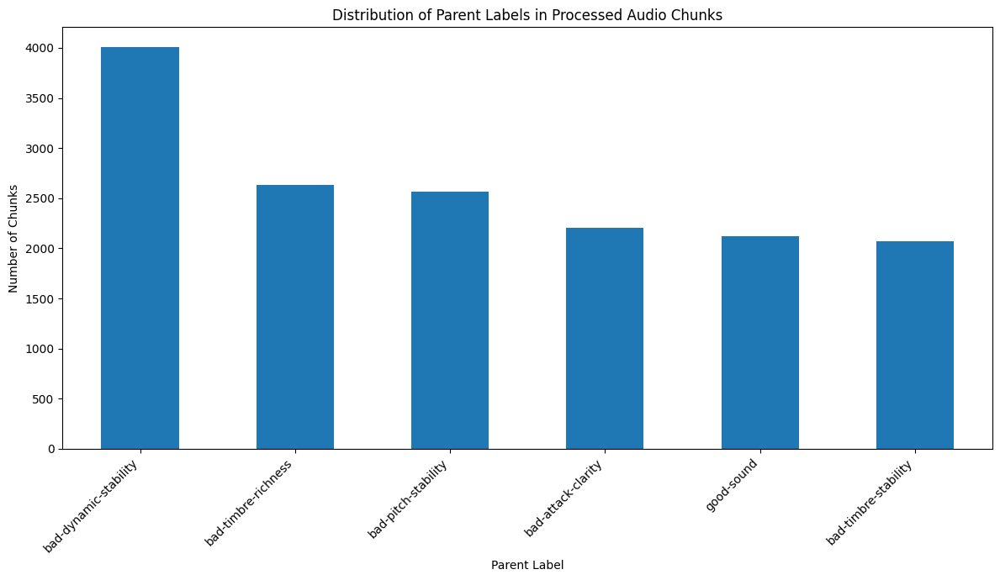

In [ ]:
import matplotlib.pyplot as plt

#@title have a look at the class distributions
display_class_distribution(chunked_df)

### sense check the dataset

In [ ]:
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader

# Load a small batch from your dataset
dataset = AudioChunkDataset(chunked_df, augment=False)  # df is your DataFrame
loader = DataLoader(dataset, batch_size=4, shuffle=True)

# Get one batch
mel_specs, labels = next(iter(loader))  # mel_specs shape: (B, 1, 128, 128)

# Plot the Mel spectrograms
fig, axs = plt.subplots(1, 4, figsize=(20, 5))

for i in range(4):
    mel = mel_specs[i][0].cpu().numpy()  # shape: (128, 128), already normalized
    axs[i].imshow(mel, aspect='auto', origin='lower', cmap='magma')
    axs[i].set_title(f"Label: {labels[i].item()}")
    axs[i].set_xlabel("Time")
    axs[i].set_ylabel("Mel freq")
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.tight_layout()
plt.show()

### > call train

In [ ]:
# train_val_df, test_df = train_test_split(chunked_df, test_size=0.1, stratify=chunked_df['encoded_parent_label'], random_state=42)
# train_df, val_df = train_test_split(train_val_df, test_size=0.2, stratify=train_val_df['encoded_parent_label'], random_state=42)

train_df, val_df = train_test_split(
        chunked_df,
        test_size=0.2, # 20% for validation
        random_state=42, # for reproducibility
        stratify=chunked_df['encoded_parent_label'] # Stratify by parent_label
    )

train_dataset = AudioChunkDataset(train_df, augment=False)
val_dataset = AudioChunkDataset(val_df, augment=False)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=2)


# Instantiate your model
num_classes = len(chunked_df['encoded_parent_label'].unique())  # adjust as needed
model = SimpleCNN(num_classes)

# model = BiggerCNN(num_classes)

total_params = sum(p.numel() for p in model.parameters())
print(f"Number of parameters: {total_params}")

# Run training
train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=10,
    lr=0.001,
    device='cuda' if torch.cuda.is_available() else 'cpu',
    save_path="best_model.pth"
)


Number of parameters: 2494054
Training model with  cuda

Epoch 1/10


Training: 100%|██████████| 390/390 [01:36<00:00,  4.05it/s]


Train Loss: 1.7737, Acc: 0.2672 | Val Loss: 1.6891, Acc: 0.2896
Saved model with val acc: 0.2896

Epoch 2/10


Training: 100%|██████████| 390/390 [01:34<00:00,  4.11it/s]


Train Loss: 1.6801, Acc: 0.2830 | Val Loss: 1.6499, Acc: 0.2935
Saved model with val acc: 0.2935

Epoch 3/10


Training: 100%|██████████| 390/390 [01:32<00:00,  4.20it/s]


Train Loss: 1.6477, Acc: 0.2891 | Val Loss: 1.6445, Acc: 0.3031
Saved model with val acc: 0.3031

Epoch 4/10


Training: 100%|██████████| 390/390 [01:33<00:00,  4.19it/s]


Train Loss: 1.6295, Acc: 0.2949 | Val Loss: 1.6124, Acc: 0.3053
Saved model with val acc: 0.3053

Epoch 5/10


Training: 100%|██████████| 390/390 [01:38<00:00,  3.98it/s]


Train Loss: 1.6109, Acc: 0.2998 | Val Loss: 1.6236, Acc: 0.2963

Epoch 6/10


Training: 100%|██████████| 390/390 [01:34<00:00,  4.15it/s]


Train Loss: 1.5910, Acc: 0.3057 | Val Loss: 1.5378, Acc: 0.3262
Saved model with val acc: 0.3262

Epoch 7/10


Training: 100%|██████████| 390/390 [01:35<00:00,  4.07it/s]


Train Loss: 1.5737, Acc: 0.3066 | Val Loss: 1.5805, Acc: 0.3223

Epoch 8/10


Training: 100%|██████████| 390/390 [01:33<00:00,  4.18it/s]


Train Loss: 1.5649, Acc: 0.3125 | Val Loss: 1.5008, Acc: 0.3396
Saved model with val acc: 0.3396

Epoch 9/10


Training: 100%|██████████| 390/390 [01:34<00:00,  4.11it/s]


Train Loss: 1.5546, Acc: 0.3113 | Val Loss: 1.5109, Acc: 0.3345

Epoch 10/10


Training: 100%|██████████| 390/390 [01:35<00:00,  4.10it/s]


Train Loss: 1.5293, Acc: 0.3176 | Val Loss: 1.4900, Acc: 0.3368

Training complete.


### old train function test

In [ ]:
#@title init model and data test


# --- Setup and DataLoaders ---

# Assuming violin_files_df_filtered is already loaded and processed with 'spectrogram_path'
# and 'encoded_parent_label' columns.
# Also assuming label_to_class is defined.

# Check if dataframe is not empty and has required columns
if 'encoded_parent_label' not in chunked_df.columns:
    print("Error: Dataframe does not have 'spectrogram_path' or 'encoded_parent_label' columns.")
    print("Please ensure the previous steps for creating spectrogram paths and encoding labels were successful.")
    # You might want to exit or raise an error here
else:
    # Split data into training and validation sets
    # Stratify to maintain class distribution
    train_df, val_df = train_test_split(
        chunked_df,
        test_size=0.2, # 20% for validation
        random_state=42, # for reproducibility
        stratify=chunked_df['encoded_parent_label'] # Stratify by parent_label
    )

    print(f"\nTraining samples in DataFrame: {len(train_df)}")
    print(f"Validation samples in DataFrame: {len(val_df)}")

    # if spectrogram_file_list_output_path does not exist
    # if not os.path.exists(spectrogram_file_list_output_path):
    #     generate_spectrogram_file_list(train_df, spectrogram_file_list_output_path)
    #     generate_spectrogram_file_list(val_df, spectrogram_file_list_output_path)

    # Create Dataset instances
    # No specific transformations needed for this simple example, just converting to tensor and reshaping.
    # In future add transforms like random noise, time/frequency masks for data augmentation later...
    train_dataset = AudioChunkDataset(train_df, augment=False)
    val_dataset = AudioChunkDataset(val_df, augment=False)

    # Create DataLoader instances
    # train_dataset = (spectrogram_file_list_output_path, label_to_class)
    # val_dataset = SpectrogramDataset(spectrogram_file_list_output_path, label_to_class)

    # Create DataLoader instances
    batch_size = 32 # You can adjust this based on your GPU memory
    train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2) # num_workers > 0 can speed up loading
    val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    print(f"\nTrain DataLoader created with {len(train_dataloader)} batches of size {batch_size}.")
    print(f"Validation DataLoader created with {len(val_dataloader)} batches of size {batch_size}.")

    # --- Instantiate the Model ---
    num_classes = len(label_to_class)
    # model = SmallerCNN(num_classes=num_classes)
    model = SimpleCNN(num_classes=num_classes)

    # Move model to GPU if available
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    print(f"\nModel instantiated with {num_classes} output classes.")
    print(f"Using device: {device}")
    print(model)

    # --- Get a batch from the DataLoader to check shapes ---
    try:
        # Get one batch
        dataiter = iter(train_dataloader)
        spectrograms, labels = next(dataiter)

        print("\nExample batch shapes:")
        print(f"Spectrogram batch shape: {spectrograms.shape}") # Should be (batch_size, 1, n_mels, target_spectrogram_width)
        print(f"Labels batch shape: {labels.shape}")           # Should be (batch_size,)

        # Check model output shape
        model.eval() # Set model to evaluation mode
        with torch.no_grad():
            outputs = model(spectrograms.to(device))
        print(f"Model output shape: {outputs.shape}") # Should be (batch_size, num_classes)

    except Exception as e:
        print(f"\nError getting example batch: {e}")
        print("Please ensure the SpectrogramDataset is correctly collecting files and returning data.")


# train_dataloader: DataLoader for training data
# val_dataloader: DataLoader for validation data
# model: Your CNN model, moved to the appropriate device
train_model(
    model=model,
    train_dataloader=train_dataloader,
    val_dataloader=val_dataloader,
    train_dataset=train_dataset,
    val_dataset=val_dataset,
    device=device,
    num_epochs=100,
    lr=0.001,
    model_save_path="/content/drive/My Drive/models/violin_spectrogram_classifier/simple_spectrogram_cnn_model_100_epoch_bs_32.pth",
    log_dir="./runs/train_logs"
)


Training samples in DataFrame: 12470
Validation samples in DataFrame: 3118

Train DataLoader created with 390 batches of size 32.
Validation DataLoader created with 98 batches of size 32.

Model instantiated with 6 output classes.
Using device: cuda
SimpleCNN(
  (conv1): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, 

Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.14it/s]


Train Loss: 1.7059, Train Accuracy: 0.3362


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.19it/s]


Validation Loss: 1.4018, Validation Accuracy: 0.4147
Epoch 2/100


Training Batches: 100%|██████████| 390/390 [01:37<00:00,  3.99it/s]


Train Loss: 1.3717, Train Accuracy: 0.4213


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.14it/s]


Validation Loss: 1.2398, Validation Accuracy: 0.4737
Epoch 3/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.15it/s]


Train Loss: 1.2740, Train Accuracy: 0.4540


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.09it/s]


Validation Loss: 1.2352, Validation Accuracy: 0.4788
Epoch 4/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.12it/s]


Train Loss: 1.1961, Train Accuracy: 0.4879


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.11it/s]


Validation Loss: 1.1572, Validation Accuracy: 0.5205
Epoch 5/100


Training Batches: 100%|██████████| 390/390 [01:33<00:00,  4.19it/s]


Train Loss: 1.1435, Train Accuracy: 0.5162


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.10it/s]


Validation Loss: 1.0689, Validation Accuracy: 0.5385
Epoch 6/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.14it/s]


Train Loss: 1.0929, Train Accuracy: 0.5370


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.09it/s]


Validation Loss: 0.9846, Validation Accuracy: 0.5895
Epoch 7/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.15it/s]


Train Loss: 1.0476, Train Accuracy: 0.5574


Validation Batches: 100%|██████████| 98/98 [00:21<00:00,  4.48it/s]


Validation Loss: 0.9621, Validation Accuracy: 0.6081
Epoch 8/100


Training Batches: 100%|██████████| 390/390 [01:33<00:00,  4.15it/s]


Train Loss: 1.0004, Train Accuracy: 0.5754


Validation Batches: 100%|██████████| 98/98 [00:24<00:00,  3.97it/s]


Validation Loss: 0.9360, Validation Accuracy: 0.6235
Epoch 9/100


Training Batches: 100%|██████████| 390/390 [01:32<00:00,  4.20it/s]


Train Loss: 0.9639, Train Accuracy: 0.5943


Validation Batches: 100%|██████████| 98/98 [00:24<00:00,  4.07it/s]


Validation Loss: 0.9483, Validation Accuracy: 0.6155
Epoch 10/100


Training Batches: 100%|██████████| 390/390 [01:33<00:00,  4.19it/s]


Train Loss: 0.9301, Train Accuracy: 0.6027


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.16it/s]


Validation Loss: 0.8229, Validation Accuracy: 0.6568
Epoch 11/100


Training Batches: 100%|██████████| 390/390 [01:36<00:00,  4.05it/s]


Train Loss: 0.8969, Train Accuracy: 0.6225


Validation Batches: 100%|██████████| 98/98 [00:24<00:00,  4.05it/s]


Validation Loss: 0.9038, Validation Accuracy: 0.6418
Epoch 12/100


Training Batches: 100%|██████████| 390/390 [01:33<00:00,  4.19it/s]


Train Loss: 0.8635, Train Accuracy: 0.6367


Validation Batches: 100%|██████████| 98/98 [00:22<00:00,  4.42it/s]


Validation Loss: 0.8106, Validation Accuracy: 0.6713
Epoch 13/100


Training Batches: 100%|██████████| 390/390 [01:36<00:00,  4.05it/s]


Train Loss: 0.8273, Train Accuracy: 0.6522


Validation Batches: 100%|██████████| 98/98 [00:21<00:00,  4.51it/s]


Validation Loss: 0.8098, Validation Accuracy: 0.6716
Epoch 14/100


Training Batches: 100%|██████████| 390/390 [01:32<00:00,  4.20it/s]


Train Loss: 0.8011, Train Accuracy: 0.6633


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.25it/s]


Validation Loss: 0.8126, Validation Accuracy: 0.6742
Epoch 15/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.12it/s]


Train Loss: 0.7679, Train Accuracy: 0.6748


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.14it/s]


Validation Loss: 0.7521, Validation Accuracy: 0.7094
Epoch 16/100


Training Batches: 100%|██████████| 390/390 [01:32<00:00,  4.22it/s]


Train Loss: 0.7421, Train Accuracy: 0.6901


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.16it/s]


Validation Loss: 0.7597, Validation Accuracy: 0.7059
Epoch 17/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.14it/s]


Train Loss: 0.7213, Train Accuracy: 0.6987


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.24it/s]


Validation Loss: 0.7109, Validation Accuracy: 0.7056
Epoch 18/100


Training Batches: 100%|██████████| 390/390 [01:33<00:00,  4.17it/s]


Train Loss: 0.7045, Train Accuracy: 0.7055


Validation Batches: 100%|██████████| 98/98 [00:21<00:00,  4.48it/s]


Validation Loss: 0.7567, Validation Accuracy: 0.7030
Epoch 19/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.14it/s]


Train Loss: 0.6795, Train Accuracy: 0.7146


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.12it/s]


Validation Loss: 0.7195, Validation Accuracy: 0.7146
Epoch 20/100


Training Batches: 100%|██████████| 390/390 [01:31<00:00,  4.24it/s]


Train Loss: 0.6584, Train Accuracy: 0.7263


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.14it/s]


Validation Loss: 0.7158, Validation Accuracy: 0.7226
Epoch 21/100


Training Batches: 100%|██████████| 390/390 [01:34<00:00,  4.13it/s]


Train Loss: 0.6313, Train Accuracy: 0.7388


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.22it/s]


Validation Loss: 0.6635, Validation Accuracy: 0.7450
Epoch 22/100


Training Batches: 100%|██████████| 390/390 [01:32<00:00,  4.23it/s]


Train Loss: 0.6096, Train Accuracy: 0.7424


Validation Batches: 100%|██████████| 98/98 [00:21<00:00,  4.53it/s]


Validation Loss: 0.6909, Validation Accuracy: 0.7287
Epoch 23/100


Training Batches: 100%|██████████| 390/390 [01:35<00:00,  4.07it/s]


Train Loss: 0.6017, Train Accuracy: 0.7478


Validation Batches: 100%|██████████| 98/98 [00:21<00:00,  4.51it/s]


Validation Loss: 0.6579, Validation Accuracy: 0.7540
Epoch 24/100


Training Batches: 100%|██████████| 390/390 [01:31<00:00,  4.27it/s]


Train Loss: 0.5770, Train Accuracy: 0.7557


Validation Batches: 100%|██████████| 98/98 [00:23<00:00,  4.17it/s]


Validation Loss: 0.6789, Validation Accuracy: 0.7453
Epoch 25/100


Training Batches: 100%|██████████| 390/390 [01:33<00:00,  4.19it/s]


Train Loss: 0.5756, Train Accuracy: 0.7582


Validation Batches: 100%|██████████| 98/98 [00:22<00:00,  4.43it/s]


Validation Loss: 0.6569, Validation Accuracy: 0.7514
Epoch 26/100


Training Batches: 100%|██████████| 390/390 [01:32<00:00,  4.21it/s]


Train Loss: 0.5476, Train Accuracy: 0.7716


Validation Batches: 100%|██████████| 98/98 [00:21<00:00,  4.55it/s]


Validation Loss: 0.6381, Validation Accuracy: 0.7595
Epoch 27/100


Training Batches:  69%|██████▉   | 271/390 [01:04<00:29,  4.10it/s]

### tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/train_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

### test getting 128x128 mels

In [ ]:
import torch
import torchaudio
import torchaudio.transforms as T


import torch
import torchaudio

# File path
file_path = 'dataset-processed/0003_chunk0.wav'

# Load audio
waveform, sample_rate = torchaudio.load(file_path)  # waveform shape: [channels, samples]

# If stereo (2 channels), convert to mono
if waveform.shape[0] > 1:
    waveform = torch.mean(waveform, dim=0, keepdim=True)  # now [1, samples]

# Resample if not at 48kHz
target_sample_rate = 48000
if sample_rate != target_sample_rate:
    resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=target_sample_rate)
    waveform = resampler(waveform)
    sample_rate = target_sample_rate  # update for consistency

# Truncate or pad to 0.5 seconds (24000 samples)
desired_num_samples = int(target_sample_rate * 0.5)
num_samples = waveform.shape[1]

if num_samples > desired_num_samples:
    waveform = waveform[:, :desired_num_samples]
elif num_samples < desired_num_samples:
    pad_amount = desired_num_samples - num_samples
    waveform = torch.nn.functional.pad(waveform, (0, pad_amount))

# Final shape: [1, 24000] mono waveform, 0.5 seconds long, 48kHz
print(waveform.shape, sample_rate)


# Constants
sample_rate = 48000
audio_duration = 0.5  # seconds
n_samples = int(sample_rate * audio_duration)  # 24000
n_mels = 128
n_frames = 128

# Define transform
mel_spectrogram = T.MelSpectrogram(
    sample_rate=sample_rate,
    n_fft=400,             # e.g., 25ms window: 0.025*48000 = 1200 (try different values to get 128 frames)
    hop_length=187,        # Adjust to get ~128 frames for 24000 samples: hop = floor((24000 - n_fft) / 128)
    n_mels=n_mels,
    center=False,
    power=2.0,
)

# Load or generate a dummy audio input (0.5s long, mono)
# waveform = torch.randn(1, n_samples)  # shape: [1, 24000]

# Compute Mel spectrogram
mel_spec = mel_spectrogram(waveform)  # shape: [1, 128, ~128]

# Ensure it is [128, 128]
mel_spec = mel_spec[:, :, :n_frames]  # trim if slightly longer
if mel_spec.shape[-1] < n_frames:
    # Pad if fewer frames than expected
    pad_amount = n_frames - mel_spec.shape[-1]
    mel_spec = torch.nn.functional.pad(mel_spec, (0, pad_amount))

# Add channel dim: final shape [1, 128, 128] → [128, 128, 1]
mel_spec = mel_spec.squeeze(0).permute(1, 0).unsqueeze(-1)  # [time, mel, 1] if needed

torch.Size([1, 24000]) 48000


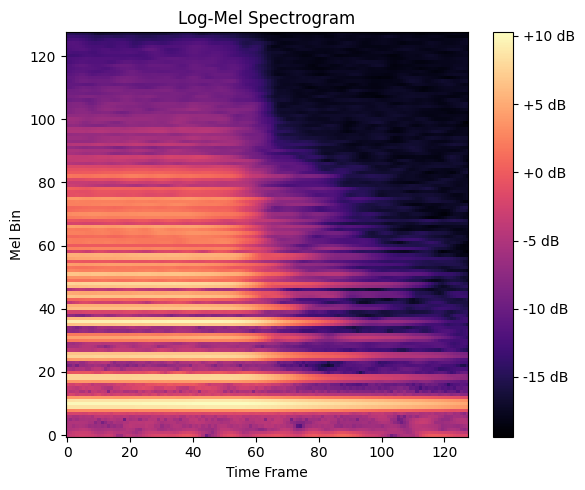

In [ ]:
import torch
import torchaudio
import torchaudio.transforms as T
import matplotlib.pyplot as plt

# === Load and preprocess audio ===

file_path = 'dataset-processed/0004_chunk13.wav'

# Load audio
waveform, sample_rate = torchaudio.load(file_path)

# Convert to mono
if waveform.shape[0] > 1:
    waveform = torch.mean(waveform, dim=0, keepdim=True)

# Resample to 48kHz if needed
target_sample_rate = 48000
if sample_rate != target_sample_rate:
    resampler = T.Resample(orig_freq=sample_rate, new_freq=target_sample_rate)
    waveform = resampler(waveform)
    sample_rate = target_sample_rate

# Pad or trim to 0.5s = 24000 samples
desired_length = int(target_sample_rate * 0.5)
num_samples = waveform.shape[1]
if num_samples > desired_length:
    waveform = waveform[:, :desired_length]
elif num_samples < desired_length:
    pad_amount = desired_length - num_samples
    waveform = torch.nn.functional.pad(waveform, (0, pad_amount))

# === Compute Mel Spectrogram ===

n_mels = 128
n_fft = 2048
hop_length = 172

mel_transform = T.MelSpectrogram(
    sample_rate=sample_rate,
    n_fft=n_fft,
    hop_length=hop_length,
    n_mels=n_mels,
    power=2.0,
    center=False,
)

mel_spec = mel_transform(waveform)  # shape: [1, 128, ~128]
mel_spec = mel_spec.squeeze(0)      # shape: [128, time_frames]

# Trim/pad to exactly 128 frames
if mel_spec.shape[1] > 128:
    print("trimming!")
    mel_spec = mel_spec[:, :128]
elif mel_spec.shape[1] < 128:
    pad_amt = 128 - mel_spec.shape[1]
    print("padding!", pad_amt)

    mel_spec = torch.nn.functional.pad(mel_spec, (0, pad_amt))

# === Plot ===

plt.figure(figsize=(6, 5))
plt.imshow(mel_spec.log2().numpy(), origin='lower', aspect='auto', cmap='magma')
plt.title("Log-Mel Spectrogram")
plt.xlabel("Time Frame")
plt.ylabel("Mel Bin")
plt.colorbar(format='%+2.0f dB')
plt.tight_layout()
plt.show()


In [ ]:


#@title Sanity check: Verify labels in Dataset and DataFrame

import numpy as np

# Assuming chunked_df and AudioChunkDataset are defined from previous cells

# Create a dataset instance (you can use either train or validation dataset)
# Let's use the full chunked_df for this check
full_dataset_check = AudioChunkDataset(chunked_df, augment=False)

print(f"Number of samples in chunked_df: {len(chunked_df)}")
print(f"Number of samples in full_dataset_check: {len(full_dataset_check)}")

# Check a few random samples
num_samples_to_check = 100
random_indices = np.random.choice(len(full_dataset_check), num_samples_to_check, replace=False)

print(f"\nChecking labels for {num_samples_to_check} random samples:")

for idx in random_indices:
    # Get label from the dataset
    _, dataset_label = full_dataset_check[idx]

    # Get the corresponding label from the original DataFrame
    df_row = chunked_df.iloc[idx]
    df_label = df_row['encoded_parent_label']
    parent_label = df_row['parent_label']
    chunk_filename = df_row['chunk_filename']


    print(f"Index {idx}:")
    print(f"  Chunk Filename: {chunk_filename}")
    print(f"  DataFrame encoded_parent_label: {df_label} ({parent_label})")
    print(f"  Dataset loaded label: {dataset_label}")

    # Assert that the labels match
    assert dataset_label == df_label, f"Label mismatch at index {idx}! DataFrame: {df_label}, Dataset: {dataset_label}"
    print("  Labels match!")

# Check the range and type of encoded labels in the DataFrame
print("\nChecking encoded label range and type in chunked_df:")
unique_encoded_labels = chunked_df['encoded_parent_label'].unique()
print(f"Unique encoded labels: {sorted(unique_encoded_labels)}")
print(f"Data type of encoded_parent_label: {chunked_df['encoded_parent_label'].dtype}")

# Check the data type of labels returned by the dataset
print("\nChecking data type of labels returned by the dataset:")
_, sample_label = full_dataset_check[0]
print(f"Data type of label from dataset: {type(sample_label)}")
if isinstance(sample_label, torch.Tensor):
    print(f"  Tensor data type: {sample_label.dtype}")


print("\nLabel sanity check complete. If no assertions failed, labels are consistent.")

Number of samples in chunked_df: 15588
Number of samples in full_dataset_check: 15588

Checking labels for 100 random samples:
Index 9184:
  Chunk Filename: /content/dataset-processed/0012_chunk13.wav
  DataFrame encoded_parent_label: 0 (bad-attack-clarity)
  Dataset loaded label: 0
  Labels match!
Index 4747:
  Chunk Filename: /content/dataset-processed/0045_chunk9.wav
  DataFrame encoded_parent_label: 2 (bad-pitch-stability)
  Dataset loaded label: 2
  Labels match!
Index 2590:
  Chunk Filename: /content/dataset-processed/0097_chunk2.wav
  DataFrame encoded_parent_label: 1 (bad-dynamic-stability)
  Dataset loaded label: 1
  Labels match!
Index 11200:
  Chunk Filename: /content/dataset-processed/0056_chunk1.wav
  DataFrame encoded_parent_label: 5 (good-sound)
  Dataset loaded label: 5
  Labels match!
Index 15191:
  Chunk Filename: /content/dataset-processed/0253_chunk3.wav
  DataFrame encoded_parent_label: 4 (bad-timbre-stability)
  Dataset loaded label: 4
  Labels match!
Index 14620:

### zip and download the dataset-preprocessed folder

In [109]:
if is_colab():
	# Download the processed dataset as a zip file
	
	!zip -r /content/dataset-processed.zip /content/dataset-processed
	from google.colab import files
	files.download('/content/dataset-processed.zip')

### Multi-Mic training and testing

### microphone splits!

In [ ]:
db_path = Config.local_dataset_dir + '/database.sqlite' # dataset_dir + '/database.sqlite'
print(db_path)
sounds_df, takes_df = load_data(db_path)

violin_single_notes_df = filter_violin_single_notes(sounds_df)
violin_files_df = merge_with_takes(violin_single_notes_df, takes_df)

violin_files_df = add_parent_label(violin_files_df, Config.parent_to_dataset_klass_mapping)

# Process filenames in the df
violin_files_df = update_filenames(violin_files_df, Config.local_dataset_dir)

# add encoded labels column
violin_files_df, label_encoder, label_to_class = filter_and_encode_labels(violin_files_df)

violin_neumann_mic_df = filter_by_mic(df=violin_files_df, mic_name="neumann")

violin_akg_mic_df = filter_by_mic(df=violin_files_df, mic_name="akg")

violin_iphone_mic_df = filter_by_mic(df=violin_files_df, mic_name="iphone")

# check the distribution of labels and totals in each of the mic dfs
print("neumman\n", violin_neumann_mic_df['parent_label'].value_counts())
print("akg\n", violin_akg_mic_df['parent_label'].value_counts())
print("iphone\n", violin_iphone_mic_df['parent_label'].value_counts())


data/datasets/violin_single_note_sound_files/database.sqlite
{np.int64(0): 'bad-attack-clarity', np.int64(1): 'bad-dynamic-stability', np.int64(2): 'bad-pitch-stability', np.int64(3): 'bad-timbre-richness', np.int64(4): 'bad-timbre-stability', np.int64(5): 'good-sound'}
neumman
 parent_label
bad-dynamic-stability    255
good-sound               141
bad-timbre-richness      111
bad-attack-clarity       110
bad-pitch-stability      108
bad-timbre-stability      74
Name: count, dtype: int64
akg
 parent_label
bad-dynamic-stability    144
bad-attack-clarity        74
bad-timbre-richness       74
bad-pitch-stability       72
good-sound                68
bad-timbre-stability      37
Name: count, dtype: int64
iphone
 parent_label
bad-dynamic-stability    110
good-sound                74
bad-timbre-stability      37
bad-timbre-richness       37
bad-attack-clarity        37
bad-pitch-stability       36
Name: count, dtype: int64


### plot comparison distribution for the different value counts of the mic dfs

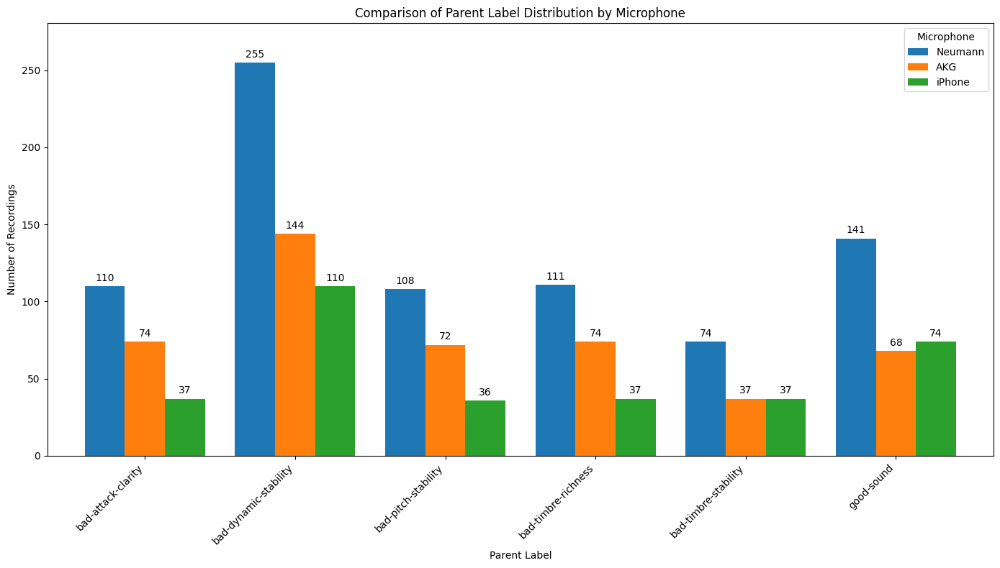

In [ ]:
import matplotlib.pyplot as plt

# Create a figure and axes
# Combine value counts for comparison
neumann_counts = violin_neumann_mic_df['parent_label'].value_counts()
akg_counts = violin_akg_mic_df['parent_label'].value_counts()
iphone_counts = violin_iphone_mic_df['parent_label'].value_counts()

# Create a combined DataFrame for easier plotting
combined_counts = pd.DataFrame({
    'Neumann': neumann_counts,
    'AKG': akg_counts,
    'iPhone': iphone_counts
}).fillna(0) # Fill missing labels with 0

# Plot the comparison distribution
ax = combined_counts.plot(kind='bar', figsize=(14, 8), width=0.8)

plt.title('Comparison of Parent Label Distribution by Microphone')
plt.xlabel('Parent Label')
plt.ylabel('Number of Recordings')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Microphone')
plt.tight_layout() # Adjust layout to prevent labels overlapping

# Add counts on top of bars
for c in ax.containers:
    ax.bar_label(c, label_type='edge', padding=3, fmt='%d')

plt.ylim(0, combined_counts.max().max() * 1.1) # Adjust y-limit to make space for labels
plt.show()

### preprocess each mic recording seperately (trim silence)

In [ ]:
# Preprocess audio for each microphone type only if not already done
neumann_df = preprocess_if_needed(violin_neumann_mic_df, Config.processed_dataset_dir_neumann)
akg_df = preprocess_if_needed(violin_akg_mic_df, Config.processed_dataset_dir_akg)
iphone_df = preprocess_if_needed(violin_iphone_mic_df, Config.processed_dataset_dir_iphone)

Found existing processed metadata at data/dataset-processed-neumann/processed_metadata.csv, loading...
Found existing processed metadata at data/dataset-processed-akg/processed_metadata.csv, loading...
Found existing processed metadata at data/dataset-processed-iphone/processed_metadata.csv, loading...


### Train on Neumann data

In [ ]:
train_dataset_neumann = AudioChunkDataset(neumann_df, augment=False) # Disable augmentation for now
train_loader_neumann = DataLoader(train_dataset_neumann, batch_size=32, shuffle=True, num_workers=2)

# Test on AKG data
test_dataset_akg = AudioChunkDataset(akg_df, augment=False)
test_loader_akg = DataLoader(test_dataset_akg, batch_size=32, shuffle=False, num_workers=2)

# Test on iPhone data
test_dataset_iphone = AudioChunkDataset(iphone_df, augment=False)
test_loader_iphone = DataLoader(test_dataset_iphone, batch_size=32, shuffle=False, num_workers=2)

# Instantiate the model (using the model defined in previous cells)
num_classes = len(label_to_class) # Ensure label_to_class is defined from previous steps
model = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

print(f"Training model on Neumann dataset ({len(neumann_df)} samples)")
print(f"Testing on AKG dataset ({len(akg_df)} samples) and iPhone dataset ({len(iphone_df)} samples)")
print(f"Using device: {device}")

# Define criterion for training and evaluation
criterion = nn.CrossEntropyLoss()


# --- Training ---
# Train the model using the Neumann data loader
# Using the 'train_model' function defined previously
train_model(
    model=model,
    train_loader=train_loader_neumann,
    val_loader=test_loader_akg, # Using AKG as a "validation" set during training
    num_epochs=50, # Adjust epochs as needed
    lr=0.001,
    device=device,
    save_path="/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_trained_model.pth",
    log_dir="./runs/neumann_train"
)

# --- Testing ---
# Load the best model saved during training (if save_path was used)
try:
    model.load_state_dict(torch.load("/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_trained_model.pth"))
    print("Loaded best model for testing.")
except FileNotFoundError:
    print("Model not saved. Testing with the model after the last training epoch.")

model.eval() # Set model to evaluation mode

print("\nEvaluating on AKG test set:")
akg_loss, akg_acc = evaluate(model, test_loader_akg, criterion, device)
print(f"AKG Test Loss: {akg_loss:.4f}, AKG Test Accuracy: {akg_acc:.4f}")

print("\nEvaluating on iPhone test set:")
iphone_loss, iphone_acc = evaluate(model, test_loader_iphone, criterion, device)
print(f"iPhone Test Loss: {iphone_loss:.4f}, iPhone Test Accuracy: {iphone_acc:.4f}")

### Pre-generate all augmentations

#### define augmentations to use

In [ ]:
from audiomentations import Compose, AddGaussianNoise, Gain, Shift, HighPassFilter, LowPassFilter, ApplyImpulseResponse

# augmentations to use

# Define augmentation pipelines
augmentations = {
	"original": Compose([]),
	"gaussian_noise": Compose([AddGaussianNoise(min_amplitude=0.01, max_amplitude=0.015, p=1.0)]),
	"gain": Compose([Gain(min_gain_db=-12.0, max_gain_db=12.0, p=1.0)]),
	"shift": Compose([Shift(min_shift=-0.2, max_shift=0.2, p=1.0)]),
	"highpass": Compose([HighPassFilter(min_cutoff_freq=1000.0, max_cutoff_freq=3000.0, p=1.0)]),
	"lowpass": Compose([LowPassFilter(min_cutoff_freq=2000.0, max_cutoff_freq=4000.0, p=1.0)]),
	"impulse_response": Compose([ApplyImpulseResponse(ir_path="data/impulse-responses/audio-48000hz", p=1.0, leave_length_unchanged=True)])
}

#### listen to augmentations

In [ ]:
import torchaudio

import IPython.display as ipd

# Select a sample audio file from your DataFrame
sample_path = violin_akg_mic_df.iloc[0]['filename']

# Load the audio
waveform, sample_rate = torchaudio.load(sample_path)
if waveform.shape[0] > 1:
	waveform = torch.mean(waveform, dim=0, keepdim=True)
audio_np = waveform[0].numpy()

# Apply each augmentation and play the result
for name, aug in augmentations.items():
	augmented = aug(samples=audio_np, sample_rate=sample_rate)
	print(f"\n{name} audio:")
	ipd.display(ipd.Audio(augmented, rate=sample_rate))


original audio:



gaussian_noise audio:



gain audio:



shift audio:



highpass audio:



lowpass audio:



impulse_response audio:


#### copy the impulse response files and resample if needed.

In [ ]:
copy_or_resample_to_48000hz(
    src_dir="data/impulse-responses/Audio/Audio",
    dst_dir="data/impulse-responses/audio-48000hz"
)

Error processing .DS_Store: Failed to open the input "data/impulse-responses/Audio/Audio/.DS_Store" (Invalid data found when processing input).
Total files processed: 270
Resampled to 48000 Hz: 270
Already at 48000 Hz: 0


### pregenerate augmentations for each microphone

In [112]:
data_to_augment = {"neumann": neumann_df, "akg": akg_df, "iphone": iphone_df}

# data_to_augment = {"neumann": get_subset_by_class(neumann_df, 10), "akg": get_subset_by_class(akg_df, 10), "iphone": get_subset_by_class(iphone_df, 10)}

for name, df in data_to_augment.items():

	augmented_spectrograms_dir = Config.augmented_spectrograms_dir + f"/{name}"

	# make augmented data for a given microphone
	for augmentation_type in augmentations.keys():
		print(f"\nGenerating augmented Mel spectrograms for {name} with {augmentation_type} augmentation...")

		# Create a subdirectory for the curr.ent augmentation type
		augmented_dir = os.path.join(augmented_spectrograms_dir, augmentation_type)
		os.makedirs(augmented_dir, exist_ok=True)

		# Generate augmented Mel spectrograms
		pregenerate_augmented_mels(
			df,
			output_base_dir=augmented_dir,
			num_augmentations_per_sample=1,
			augmentations=augmentations[augmentation_type],
			disable_augmentations=False,
			save_originals=False
		)


Generating augmented Mel spectrograms for neumann with original augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:41<00:00, 189.78it/s]



Generating augmented Mel spectrograms for neumann with gaussian_noise augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:37<00:00, 209.92it/s]



Generating augmented Mel spectrograms for neumann with gain augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:38<00:00, 205.95it/s]



Generating augmented Mel spectrograms for neumann with shift augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:37<00:00, 211.10it/s]



Generating augmented Mel spectrograms for neumann with highpass augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:43<00:00, 183.75it/s]



Generating augmented Mel spectrograms for neumann with lowpass augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:43<00:00, 180.74it/s]



Generating augmented Mel spectrograms for neumann with impulse_response augmentation...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [00:54<00:00, 146.96it/s]



Generating augmented Mel spectrograms for akg with original augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:27<00:00, 198.36it/s]



Generating augmented Mel spectrograms for akg with gaussian_noise augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:25<00:00, 212.37it/s]



Generating augmented Mel spectrograms for akg with gain augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:23<00:00, 229.39it/s]



Generating augmented Mel spectrograms for akg with shift augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:22<00:00, 238.10it/s]



Generating augmented Mel spectrograms for akg with highpass augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:28<00:00, 192.80it/s]



Generating augmented Mel spectrograms for akg with lowpass augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:28<00:00, 194.49it/s]



Generating augmented Mel spectrograms for akg with impulse_response augmentation...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:35<00:00, 153.73it/s]



Generating augmented Mel spectrograms for iphone with original augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:11<00:00, 189.25it/s]



Generating augmented Mel spectrograms for iphone with gaussian_noise augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:11<00:00, 194.58it/s]



Generating augmented Mel spectrograms for iphone with gain augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:09<00:00, 240.93it/s]



Generating augmented Mel spectrograms for iphone with shift augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:09<00:00, 238.76it/s]



Generating augmented Mel spectrograms for iphone with highpass augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:11<00:00, 185.27it/s]



Generating augmented Mel spectrograms for iphone with lowpass augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:12<00:00, 175.37it/s]



Generating augmented Mel spectrograms for iphone with impulse_response augmentation...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:14<00:00, 150.31it/s]


### train with different combinations of augmentations

In [113]:
aug_configs = [
    {
        "name": "original_only",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "akg", "aug": "original"},
        ]
    },
    {
        "name": "original_plus_noise",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "neumann", "aug": "gaussian_noise"},
            {"mic": "akg", "aug": "original"},
            {"mic": "akg", "aug": "gaussian_noise"},
        ]
    },
    {
        "name": "original_plus_gain",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "neumann", "aug": "gain"},
            {"mic": "akg", "aug": "original"},
            {"mic": "akg", "aug": "gain"},
        ]
    },
    {
        "name": "original_plus_shift",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "neumann", "aug": "shift"},
            {"mic": "akg", "aug": "original"},
            {"mic": "akg", "aug": "shift"},
        ]
    },
    {
        "name": "original_plus_filters",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "neumann", "aug": "highpass"},
            {"mic": "neumann", "aug": "lowpass"},
            {"mic": "akg", "aug": "original"},
            {"mic": "akg", "aug": "highpass"},
            {"mic": "akg", "aug": "lowpass"},
        ]
    },
    {
        "name": "original_plus_ir",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "neumann", "aug": "impulse_response"},
            {"mic": "akg", "aug": "original"},
            {"mic": "akg", "aug": "impulse_response"},
        ]
    },
    {
        "name": "all_aug_combined",
        "train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "neumann", "aug": "gaussian_noise"},
            {"mic": "neumann", "aug": "gain"},
            {"mic": "neumann", "aug": "shift"},
            {"mic": "neumann", "aug": "highpass"},
            {"mic": "neumann", "aug": "lowpass"},
            {"mic": "neumann", "aug": "impulse_response"},
            {"mic": "akg", "aug": "original"},
            {"mic": "akg", "aug": "gaussian_noise"},
            {"mic": "akg", "aug": "gain"},
            {"mic": "akg", "aug": "shift"},
            {"mic": "akg", "aug": "highpass"},
            {"mic": "akg", "aug": "lowpass"},
            {"mic": "akg", "aug": "impulse_response"},
        ]
    }
]


from copy import deepcopy

for aug_config in aug_configs:
    experiment_name = f"{aug_config['name']}"
    print(f"\n=== Training: {experiment_name} ===")
    
    # Load data for this augmentation config
    train_loader, test_loader, train_df, test_df = load_augmented_data(
        config={
            "train": deepcopy(aug_config["train"]),
            "test": [
                {"mic": "iphone", "aug": "original"}  # consistent test set
            ]
        },
        augmented_base_dir=Config.augmented_spectrograms_dir,
        batch_size=Config.batch_size
    )
    
    # Create new model each time
    model = SimpleCNN(num_classes=len(label_to_class))
    model.to(Config.device)
    
    train_model_pregenerated(
        model=model,
        train_loader=train_loader,
        val_loader=test_loader,
        params={
            "experiment_name": experiment_name,
            "batch_size": Config.batch_size,
            "num_epochs": 10,
            "lr": 0.001
        },
        device=Config.device,
        save=True,
        log_dir=Config.experiments_dir
    )

import pandas as pd
import matplotlib.pyplot as plt

def plot_results(log_dir, config_names):
    for name in config_names:
        log_path = os.path.join(log_dir, name, f"{name}_train_log.csv")
        df = pd.read_csv(log_path)
        plt.plot(df["val_acc"], label=name)
    
    plt.title("Validation Accuracy Comparison")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.grid()
    plt.show()

plot_results(Config.experiments_dir, [cfg["name"] for cfg in aug_configs])


=== Training: original_only ===
Training pregenerated model with  cpu
Created log directory: logs/original_only

Epoch 1/10


Training: 100%|██████████| 419/419 [01:00<00:00,  6.91it/s]


Train Loss: 1.6855, Acc: 0.3219 | Val Loss: 2.2004, Acc: 0.1883
Saved model with val acc: 0.1883

Epoch 2/10


Training: 100%|██████████| 419/419 [00:56<00:00,  7.38it/s]


Train Loss: 1.3109, Acc: 0.4284 | Val Loss: 4.3866, Acc: 0.3268
Saved model with val acc: 0.3268

Epoch 3/10


Training: 100%|██████████| 419/419 [00:53<00:00,  7.78it/s]


Train Loss: 1.1982, Acc: 0.4822 | Val Loss: 3.9351, Acc: 0.3944
Saved model with val acc: 0.3944

Epoch 4/10


Training: 100%|██████████| 419/419 [00:53<00:00,  7.89it/s]


Train Loss: 1.1296, Acc: 0.5110 | Val Loss: 5.9308, Acc: 0.3967
Saved model with val acc: 0.3967

Epoch 5/10


Training: 100%|██████████| 419/419 [00:49<00:00,  8.38it/s]


Train Loss: 1.0566, Acc: 0.5360 | Val Loss: 6.1993, Acc: 0.3985
Saved model with val acc: 0.3985

Epoch 6/10


Training: 100%|██████████| 419/419 [00:51<00:00,  8.12it/s]


Train Loss: 1.0066, Acc: 0.5646 | Val Loss: 7.5127, Acc: 0.4054
Saved model with val acc: 0.4054

Epoch 7/10


Training: 100%|██████████| 419/419 [00:50<00:00,  8.36it/s]


Train Loss: 0.9518, Acc: 0.5837 | Val Loss: 7.5135, Acc: 0.3921

Epoch 8/10


Training: 100%|██████████| 419/419 [00:50<00:00,  8.26it/s]


Train Loss: 0.9231, Acc: 0.6011 | Val Loss: 7.0462, Acc: 0.3707

Epoch 9/10


Training: 100%|██████████| 419/419 [00:47<00:00,  8.86it/s]


Train Loss: 0.8634, Acc: 0.6266 | Val Loss: 6.4311, Acc: 0.4177
Saved model with val acc: 0.4177

Epoch 10/10


Training: 100%|██████████| 419/419 [00:44<00:00,  9.38it/s]


Train Loss: 0.8202, Acc: 0.6443 | Val Loss: 8.3882, Acc: 0.3940

Saving training params as json

Training complete.

=== Training: original_plus_noise ===
Training pregenerated model with  cpu
Created log directory: logs/original_plus_noise

Epoch 1/10


Training: 100%|██████████| 838/838 [01:28<00:00,  9.51it/s]


Train Loss: 1.7395, Acc: 0.2753 | Val Loss: 2.0065, Acc: 0.3515
Saved model with val acc: 0.3515

Epoch 2/10


Training: 100%|██████████| 838/838 [01:27<00:00,  9.59it/s]


Train Loss: 1.5248, Acc: 0.3399 | Val Loss: 2.2578, Acc: 0.2806

Epoch 3/10


Training: 100%|██████████| 838/838 [01:28<00:00,  9.49it/s]


Train Loss: 1.3928, Acc: 0.4073 | Val Loss: 2.2137, Acc: 0.3112

Epoch 4/10


Training: 100%|██████████| 838/838 [01:26<00:00,  9.73it/s]


Train Loss: 1.3200, Acc: 0.4391 | Val Loss: 2.2825, Acc: 0.2888

Epoch 5/10


Training: 100%|██████████| 838/838 [01:23<00:00, 10.06it/s]


Train Loss: 1.2506, Acc: 0.4634 | Val Loss: 2.7971, Acc: 0.3382

Epoch 6/10


Training: 100%|██████████| 838/838 [01:33<00:00,  8.98it/s]


Train Loss: 1.1915, Acc: 0.4867 | Val Loss: 3.4613, Acc: 0.3441

Epoch 7/10


Training: 100%|██████████| 838/838 [01:36<00:00,  8.72it/s]


Train Loss: 1.1492, Acc: 0.5084 | Val Loss: 3.4963, Acc: 0.3181

Epoch 8/10


Training: 100%|██████████| 838/838 [01:31<00:00,  9.12it/s]


Train Loss: 1.1084, Acc: 0.5284 | Val Loss: 4.2476, Acc: 0.3633
Saved model with val acc: 0.3633

Epoch 9/10


Training: 100%|██████████| 838/838 [01:32<00:00,  9.05it/s]


Train Loss: 1.0650, Acc: 0.5462 | Val Loss: 3.6047, Acc: 0.3268

Epoch 10/10


Training: 100%|██████████| 838/838 [01:32<00:00,  9.06it/s]


Train Loss: 1.0289, Acc: 0.5668 | Val Loss: 4.0952, Acc: 0.3496

Saving training params as json

Training complete.

=== Training: original_plus_gain ===
Training pregenerated model with  cpu
Created log directory: logs/original_plus_gain

Epoch 1/10


Training: 100%|██████████| 838/838 [01:35<00:00,  8.77it/s]


Train Loss: 1.5297, Acc: 0.3669 | Val Loss: 3.1834, Acc: 0.3921
Saved model with val acc: 0.3921

Epoch 2/10


Training: 100%|██████████| 838/838 [01:33<00:00,  8.98it/s]


Train Loss: 1.1645, Acc: 0.5004 | Val Loss: 3.9174, Acc: 0.3268

Epoch 3/10


Training: 100%|██████████| 838/838 [01:34<00:00,  8.89it/s]


Train Loss: 1.0279, Acc: 0.5543 | Val Loss: 4.3674, Acc: 0.3967
Saved model with val acc: 0.3967

Epoch 4/10


Training: 100%|██████████| 838/838 [01:33<00:00,  8.93it/s]


Train Loss: 0.9300, Acc: 0.6003 | Val Loss: 5.3710, Acc: 0.3739

Epoch 5/10


Training: 100%|██████████| 838/838 [01:37<00:00,  8.63it/s]


Train Loss: 0.8548, Acc: 0.6259 | Val Loss: 6.4068, Acc: 0.3912

Epoch 6/10


Training: 100%|██████████| 838/838 [01:34<00:00,  8.87it/s]


Train Loss: 0.7892, Acc: 0.6581 | Val Loss: 5.3961, Acc: 0.3771

Epoch 7/10


Training: 100%|██████████| 838/838 [01:35<00:00,  8.80it/s]


Train Loss: 0.7289, Acc: 0.6855 | Val Loss: 5.4552, Acc: 0.4022
Saved model with val acc: 0.4022

Epoch 8/10


Training: 100%|██████████| 838/838 [01:31<00:00,  9.18it/s]


Train Loss: 0.6909, Acc: 0.7010 | Val Loss: 6.2050, Acc: 0.3963

Epoch 9/10


Training: 100%|██████████| 838/838 [01:33<00:00,  9.01it/s]


Train Loss: 0.6239, Acc: 0.7299 | Val Loss: 6.3999, Acc: 0.4072
Saved model with val acc: 0.4072

Epoch 10/10


Training: 100%|██████████| 838/838 [01:40<00:00,  8.33it/s]


Train Loss: 0.5771, Acc: 0.7542 | Val Loss: 6.2644, Acc: 0.3990

Saving training params as json

Training complete.

=== Training: original_plus_shift ===
Training pregenerated model with  cpu
Created log directory: logs/original_plus_shift

Epoch 1/10


Training: 100%|██████████| 838/838 [01:48<00:00,  7.74it/s]


Train Loss: 1.4043, Acc: 0.4129 | Val Loss: 3.1200, Acc: 0.4013
Saved model with val acc: 0.4013

Epoch 2/10


Training: 100%|██████████| 838/838 [03:24<00:00,  4.10it/s]


Train Loss: 1.0870, Acc: 0.5297 | Val Loss: 4.5498, Acc: 0.4191
Saved model with val acc: 0.4191

Epoch 3/10


Training: 100%|██████████| 838/838 [02:59<00:00,  4.67it/s]


Train Loss: 0.9468, Acc: 0.5932 | Val Loss: 5.3584, Acc: 0.3771

Epoch 4/10


Training: 100%|██████████| 838/838 [02:32<00:00,  5.48it/s]


Train Loss: 0.8570, Acc: 0.6349 | Val Loss: 6.2738, Acc: 0.3926

Epoch 5/10


Training: 100%|██████████| 838/838 [03:04<00:00,  4.53it/s]


Train Loss: 0.7789, Acc: 0.6655 | Val Loss: 6.2616, Acc: 0.4022

Epoch 6/10


Training: 100%|██████████| 838/838 [02:54<00:00,  4.79it/s]


Train Loss: 0.7066, Acc: 0.7013 | Val Loss: 8.2740, Acc: 0.4049

Epoch 7/10


Training: 100%|██████████| 838/838 [02:42<00:00,  5.17it/s]


Train Loss: 0.6380, Acc: 0.7316 | Val Loss: 7.6696, Acc: 0.4136

Epoch 8/10


Training: 100%|██████████| 838/838 [03:00<00:00,  4.63it/s]


Train Loss: 0.5910, Acc: 0.7506 | Val Loss: 8.5031, Acc: 0.3981

Epoch 9/10


Training: 100%|██████████| 838/838 [02:54<00:00,  4.79it/s]


Train Loss: 0.5396, Acc: 0.7753 | Val Loss: 9.2788, Acc: 0.3967

Epoch 10/10


Training: 100%|██████████| 838/838 [02:59<00:00,  4.67it/s]


Train Loss: 0.5117, Acc: 0.7865 | Val Loss: 10.3506, Acc: 0.3949

Saving training params as json

Training complete.

=== Training: original_plus_filters ===
Training pregenerated model with  cpu
Created log directory: logs/original_plus_filters

Epoch 1/10


Training:  25%|██▍       | 310/1257 [01:16<03:53,  4.06it/s]


KeyboardInterrupt: 

### train model with zero augmentations for fine tuning with augmented data later

In [ ]:
experiment_name = "neumann_akg_original_20epochs"
print(f"\n=== Training: {experiment_name} ===")

# Load data for this augmentation config
train_loader, test_loader, train_df, test_df = load_augmented_data(
		config={
				"train": deepcopy(aug_configs[0]["train"]),
				"test": [
						{"mic": "iphone", "aug": "original"}  # consistent test set
				]
		},
		augmented_base_dir=Config.augmented_spectrograms_dir,
		batch_size=Config.batch_size
)

# Create new model each time
model = SimpleCNN(num_classes=len(label_to_class))
model.to(Config.device)

train_model_pregenerated(
		model=model,
		train_loader=train_loader,
		val_loader=test_loader,
		params={
				"experiment_name": experiment_name,
				"batch_size": Config.batch_size,
				"num_epochs": 20,
				"lr": 0.001
		},
		device=Config.device,
		save=True,
		log_dir=Config.experiments_dir
)

import pandas as pd
import matplotlib.pyplot as plt

def plot_results(log_dir, config_names):
    for name in config_names:
        log_path = os.path.join(log_dir, name, f"{name}_train_log.csv")
        df = pd.read_csv(log_path)
        plt.plot(df["val_acc"], label=name)
    
    plt.title("Validation Accuracy Comparison")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.grid()
    plt.show()

plot_results(Config.experiments_dir, [cfg["name"] for cfg in aug_configs[:4]])

In [126]:
model = load_best_model(experiment_name="neumann_akg_original_20epochs")

evaluate_pregenerated(
		model, test_loader, criterion=nn.CrossEntropyLoss(), device=Config.device,
)


(3.9508483383184814, 0.41590493601462525)

In [127]:
#lets train the model a bit more with augmented data

experiment_name = "neumann_akg_original_20epochs_plus_noise_gain_impulse_response_10epochs"

train_loader, test_loader, train_df, test_df = load_augmented_data(
		config={
				"train": [
                            {"mic": "neumann", "aug": "gaussian_noise"},
                            {"mic": "neumann", "aug": "gain"},
                            {"mic": "neumann", "aug": "impulse_response"},
                            {"mic": "akg", "aug": "gaussian_noise"},
                            {"mic": "akg", "aug": "gain"},
                            {"mic": "akg", "aug": "impulse_response"},
                        ],
				"test": [
						{"mic": "iphone", "aug": "original"}  # consistent test set
				]
		},
		augmented_base_dir=Config.augmented_spectrograms_dir,
		batch_size=Config.batch_size
)

# Create new model each time
model = load_best_model(experiment_name="neumann_akg_original_20epochs")
model.to(Config.device)

train_model_pregenerated(
		model=model,
		train_loader=train_loader,
		val_loader=test_loader,
		params={
				"experiment_name": experiment_name,
				"batch_size": Config.batch_size,
				"num_epochs": 10,
				"lr": 0.001
		},
		device=Config.device,
		save=True,
		log_dir=Config.experiments_dir
)


Training pregenerated model with  cpu
Created log directory: logs/neumann_akg_original_20epochs_plus_noise_gain_impulse_response_10epochs

Epoch 1/10


Training: 100%|██████████| 1257/1257 [02:40<00:00,  7.85it/s]


Train Loss: 1.3524, Acc: 0.4350 | Val Loss: 2.4708, Acc: 0.3899
Saved model with val acc: 0.3899

Epoch 2/10


Training: 100%|██████████| 1257/1257 [02:37<00:00,  7.97it/s]


Train Loss: 1.2404, Acc: 0.4753 | Val Loss: 2.4918, Acc: 0.3199

Epoch 3/10


Training: 100%|██████████| 1257/1257 [02:16<00:00,  9.23it/s]


Train Loss: 1.1731, Acc: 0.4989 | Val Loss: 3.1239, Acc: 0.3739

Epoch 4/10


Training: 100%|██████████| 1257/1257 [02:14<00:00,  9.37it/s]


Train Loss: 1.1181, Acc: 0.5252 | Val Loss: 2.9904, Acc: 0.4072
Saved model with val acc: 0.4072

Epoch 5/10


Training: 100%|██████████| 1257/1257 [02:09<00:00,  9.74it/s]


Train Loss: 1.0581, Acc: 0.5489 | Val Loss: 3.3322, Acc: 0.3981

Epoch 6/10


Training: 100%|██████████| 1257/1257 [02:06<00:00,  9.96it/s]


Train Loss: 1.0159, Acc: 0.5676 | Val Loss: 3.0448, Acc: 0.3789

Epoch 7/10


Training: 100%|██████████| 1257/1257 [02:07<00:00,  9.88it/s]


Train Loss: 0.9733, Acc: 0.5864 | Val Loss: 3.1487, Acc: 0.3396

Epoch 8/10


Training: 100%|██████████| 1257/1257 [02:08<00:00,  9.76it/s]


Train Loss: 0.9345, Acc: 0.6037 | Val Loss: 3.5580, Acc: 0.3656

Epoch 9/10


Training: 100%|██████████| 1257/1257 [02:21<00:00,  8.89it/s]


Train Loss: 0.8949, Acc: 0.6197 | Val Loss: 4.2035, Acc: 0.3812

Epoch 10/10


Training: 100%|██████████| 1257/1257 [02:14<00:00,  9.31it/s]


Train Loss: 0.8693, Acc: 0.6284 | Val Loss: 3.8687, Acc: 0.3181

Saving training params as json

Training complete.


### train on all original non-augmented data then test on augmented data

In [128]:
experiment_name = "neumann_akg_iphone_original_50epochs"
print(f"\n=== Training: {experiment_name} ===")

# Load data for this augmentation config
train_loader, test_loader, train_df, test_df = load_augmented_data(
		config={
				"train": [
            {"mic": "neumann", "aug": "original"},
            {"mic": "akg", "aug": "original"},
						{"mic": "iphone", "aug": "original"}
        ],
				"test": [
						{"mic": "iphone", "aug": "original"}  # consistent test set
				]
		},
		augmented_base_dir=Config.augmented_spectrograms_dir,
		batch_size=Config.batch_size
)

# Create new model each time
model = SimpleCNN(num_classes=len(label_to_class))
model.to(Config.device)

train_model_pregenerated(
		model=model,
		train_loader=train_loader,
		val_loader=test_loader,
		params={
				"experiment_name": experiment_name,
				"batch_size": Config.batch_size,
				"num_epochs": 50,
				"lr": 0.001
		},
		device=Config.device,
		save=True,
		log_dir=Config.experiments_dir
)


=== Training: neumann_akg_iphone_original_50epochs ===
Training pregenerated model with  cpu
Created log directory: logs/neumann_akg_iphone_original_50epochs

Epoch 1/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.35it/s]


Train Loss: 1.6641, Acc: 0.3442 | Val Loss: 1.5148, Acc: 0.3880
Saved model with val acc: 0.3880

Epoch 2/50


Training: 100%|██████████| 488/488 [00:54<00:00,  9.01it/s]


Train Loss: 1.3345, Acc: 0.4363 | Val Loss: 1.4053, Acc: 0.4452
Saved model with val acc: 0.4452

Epoch 3/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.81it/s]


Train Loss: 1.2332, Acc: 0.4763 | Val Loss: 1.3109, Acc: 0.4653
Saved model with val acc: 0.4653

Epoch 4/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.85it/s]


Train Loss: 1.1484, Acc: 0.5173 | Val Loss: 1.2684, Acc: 0.4621

Epoch 5/50


Training: 100%|██████████| 488/488 [00:50<00:00,  9.59it/s]


Train Loss: 1.0752, Acc: 0.5452 | Val Loss: 1.2303, Acc: 0.4813
Saved model with val acc: 0.4813

Epoch 6/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.15it/s]


Train Loss: 1.0299, Acc: 0.5647 | Val Loss: 1.2694, Acc: 0.4616

Epoch 7/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.28it/s]


Train Loss: 0.9803, Acc: 0.5852 | Val Loss: 1.1719, Acc: 0.4954
Saved model with val acc: 0.4954

Epoch 8/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.31it/s]


Train Loss: 0.9348, Acc: 0.6119 | Val Loss: 1.1791, Acc: 0.5146
Saved model with val acc: 0.5146

Epoch 9/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.72it/s]


Train Loss: 0.8891, Acc: 0.6275 | Val Loss: 1.1110, Acc: 0.5247
Saved model with val acc: 0.5247

Epoch 10/50


Training: 100%|██████████| 488/488 [00:56<00:00,  8.68it/s]


Train Loss: 0.8426, Acc: 0.6470 | Val Loss: 1.0702, Acc: 0.5612
Saved model with val acc: 0.5612

Epoch 11/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.20it/s]


Train Loss: 0.8048, Acc: 0.6638 | Val Loss: 0.9706, Acc: 0.5964
Saved model with val acc: 0.5964

Epoch 12/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.15it/s]


Train Loss: 0.7979, Acc: 0.6705 | Val Loss: 0.9709, Acc: 0.5914

Epoch 13/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.96it/s]


Train Loss: 0.7444, Acc: 0.6924 | Val Loss: 0.9646, Acc: 0.6051
Saved model with val acc: 0.6051

Epoch 14/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.97it/s]


Train Loss: 0.7208, Acc: 0.7027 | Val Loss: 0.8726, Acc: 0.6293
Saved model with val acc: 0.6293

Epoch 15/50


Training: 100%|██████████| 488/488 [00:56<00:00,  8.64it/s]


Train Loss: 0.6913, Acc: 0.7157 | Val Loss: 0.8414, Acc: 0.6435
Saved model with val acc: 0.6435

Epoch 16/50


Training: 100%|██████████| 488/488 [00:56<00:00,  8.65it/s]


Train Loss: 0.6658, Acc: 0.7234 | Val Loss: 0.8050, Acc: 0.6682
Saved model with val acc: 0.6682

Epoch 17/50


Training: 100%|██████████| 488/488 [00:56<00:00,  8.61it/s]


Train Loss: 0.6347, Acc: 0.7364 | Val Loss: 0.7764, Acc: 0.6604

Epoch 18/50


Training: 100%|██████████| 488/488 [00:57<00:00,  8.51it/s]


Train Loss: 0.6118, Acc: 0.7440 | Val Loss: 0.7505, Acc: 0.6924
Saved model with val acc: 0.6924

Epoch 19/50


Training: 100%|██████████| 488/488 [00:56<00:00,  8.57it/s]


Train Loss: 0.5903, Acc: 0.7565 | Val Loss: 0.6936, Acc: 0.7294
Saved model with val acc: 0.7294

Epoch 20/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.76it/s]


Train Loss: 0.5807, Acc: 0.7569 | Val Loss: 0.6952, Acc: 0.7107

Epoch 21/50


Training: 100%|██████████| 488/488 [00:58<00:00,  8.38it/s]


Train Loss: 0.5509, Acc: 0.7701 | Val Loss: 0.6588, Acc: 0.7326
Saved model with val acc: 0.7326

Epoch 22/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.90it/s]


Train Loss: 0.5256, Acc: 0.7808 | Val Loss: 0.6517, Acc: 0.7441
Saved model with val acc: 0.7441

Epoch 23/50


Training: 100%|██████████| 488/488 [00:51<00:00,  9.45it/s]


Train Loss: 0.5231, Acc: 0.7814 | Val Loss: 0.6140, Acc: 0.7637
Saved model with val acc: 0.7637

Epoch 24/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.21it/s]


Train Loss: 0.4983, Acc: 0.7916 | Val Loss: 0.5407, Acc: 0.7815
Saved model with val acc: 0.7815

Epoch 25/50


Training: 100%|██████████| 488/488 [01:00<00:00,  8.10it/s]


Train Loss: 0.4820, Acc: 0.7982 | Val Loss: 0.5898, Acc: 0.7569

Epoch 26/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.98it/s]


Train Loss: 0.4803, Acc: 0.8009 | Val Loss: 0.4976, Acc: 0.8053
Saved model with val acc: 0.8053

Epoch 27/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.81it/s]


Train Loss: 0.4581, Acc: 0.8072 | Val Loss: 0.4579, Acc: 0.8222
Saved model with val acc: 0.8222

Epoch 28/50


Training: 100%|██████████| 488/488 [00:54<00:00,  9.02it/s]


Train Loss: 0.4404, Acc: 0.8152 | Val Loss: 0.4694, Acc: 0.8067

Epoch 29/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.26it/s]


Train Loss: 0.4356, Acc: 0.8129 | Val Loss: 0.4089, Acc: 0.8359
Saved model with val acc: 0.8359

Epoch 30/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.89it/s]


Train Loss: 0.4359, Acc: 0.8171 | Val Loss: 0.4611, Acc: 0.8190

Epoch 31/50


Training: 100%|██████████| 488/488 [00:57<00:00,  8.45it/s]


Train Loss: 0.4040, Acc: 0.8340 | Val Loss: 0.3987, Acc: 0.8391
Saved model with val acc: 0.8391

Epoch 32/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.11it/s]


Train Loss: 0.4104, Acc: 0.8283 | Val Loss: 0.4171, Acc: 0.8414
Saved model with val acc: 0.8414

Epoch 33/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.22it/s]


Train Loss: 0.3887, Acc: 0.8397 | Val Loss: 0.3809, Acc: 0.8455
Saved model with val acc: 0.8455

Epoch 34/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.91it/s]


Train Loss: 0.3823, Acc: 0.8403 | Val Loss: 0.4030, Acc: 0.8391

Epoch 35/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.90it/s]


Train Loss: 0.3694, Acc: 0.8474 | Val Loss: 0.3517, Acc: 0.8633
Saved model with val acc: 0.8633

Epoch 36/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.86it/s]


Train Loss: 0.3620, Acc: 0.8478 | Val Loss: 0.3700, Acc: 0.8473

Epoch 37/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.11it/s]


Train Loss: 0.3453, Acc: 0.8548 | Val Loss: 0.3531, Acc: 0.8601

Epoch 38/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.97it/s]


Train Loss: 0.3494, Acc: 0.8557 | Val Loss: 0.3455, Acc: 0.8684
Saved model with val acc: 0.8684

Epoch 39/50


Training: 100%|██████████| 488/488 [00:59<00:00,  8.27it/s]


Train Loss: 0.3480, Acc: 0.8557 | Val Loss: 0.3341, Acc: 0.8656

Epoch 40/50


Training: 100%|██████████| 488/488 [00:59<00:00,  8.19it/s]


Train Loss: 0.3343, Acc: 0.8601 | Val Loss: 0.3936, Acc: 0.8519

Epoch 41/50


Training: 100%|██████████| 488/488 [00:55<00:00,  8.83it/s]


Train Loss: 0.3314, Acc: 0.8623 | Val Loss: 0.3619, Acc: 0.8583

Epoch 42/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.10it/s]


Train Loss: 0.3186, Acc: 0.8689 | Val Loss: 0.2886, Acc: 0.8853
Saved model with val acc: 0.8853

Epoch 43/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.15it/s]


Train Loss: 0.3028, Acc: 0.8770 | Val Loss: 0.3031, Acc: 0.8780

Epoch 44/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.91it/s]


Train Loss: 0.3092, Acc: 0.8740 | Val Loss: 0.2875, Acc: 0.8807

Epoch 45/50


Training: 100%|██████████| 488/488 [00:54<00:00,  9.01it/s]


Train Loss: 0.3040, Acc: 0.8784 | Val Loss: 0.2732, Acc: 0.8876
Saved model with val acc: 0.8876

Epoch 46/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.24it/s]


Train Loss: 0.3005, Acc: 0.8765 | Val Loss: 0.2596, Acc: 0.8958
Saved model with val acc: 0.8958

Epoch 47/50


Training: 100%|██████████| 488/488 [00:53<00:00,  9.10it/s]


Train Loss: 0.2788, Acc: 0.8862 | Val Loss: 0.2727, Acc: 0.8944

Epoch 48/50


Training: 100%|██████████| 488/488 [00:54<00:00,  8.98it/s]


Train Loss: 0.2803, Acc: 0.8860 | Val Loss: 0.2780, Acc: 0.8949

Epoch 49/50


Training: 100%|██████████| 488/488 [00:52<00:00,  9.28it/s]


Train Loss: 0.2772, Acc: 0.8866 | Val Loss: 0.2576, Acc: 0.8949

Epoch 50/50


Training: 100%|██████████| 488/488 [00:54<00:00,  9.01it/s]


Train Loss: 0.2920, Acc: 0.8820 | Val Loss: 0.2684, Acc: 0.8972
Saved model with val acc: 0.8972

Saving training params as json

Training complete.


#### test this model on some augmented data to see generalization capacity for this

In [139]:
augmentations_names = ["gaussian_noise", "gain", "shift", "highpass", "lowpass", "impulse_response"]


for augmentation in augmentations_names:
		print(f"\n=== Evaluating {augmentation} augmentation ===")
		
		# Load data for this augmentation config
		train_loader, aug_test_loader, train_df, test_df = load_augmented_data(
				config={
						"train": [
								{"mic": "iphone", "aug": "original"}
						],
						"test": [
								{"mic": "iphone", "aug": augmentation}  # consistent test set
						]
				},
				augmented_base_dir=Config.augmented_spectrograms_dir,
				batch_size=Config.batch_size
		)
		
		model = load_best_model(experiment_name="neumann_akg_iphone_original_50epochs")
		
		result = evaluate_pregenerated(
				model, aug_test_loader, criterion=nn.CrossEntropyLoss(), device=Config.device,
		)

		print(f"Loss: {result[0]}, Accuracy: {result[1]}")



=== Evaluating gaussian_noise augmentation ===
Loss: 4.823881313395456, Accuracy: 0.37751371115173676

=== Evaluating gain augmentation ===
Loss: 0.2675995959115421, Accuracy: 0.8971663619744058

=== Evaluating shift augmentation ===
Loss: 0.46999596100184776, Accuracy: 0.846892138939671

=== Evaluating highpass augmentation ===
Loss: 6.076047348883514, Accuracy: 0.4259597806215722

=== Evaluating lowpass augmentation ===
Loss: 10.089659166510407, Accuracy: 0.22806215722120657

=== Evaluating impulse_response augmentation ===
Loss: 14.164113817964655, Accuracy: 0.1823583180987203


In [ ]:
train_loader, test_loader, train_df, test_df = load_augmented_data(
		config={
				"train": [
						{"mic": "neumann", "aug": "original"},
						{"mic": "neumann", "aug": "gaussian_noise"},
						{"mic": "akg", "aug": "original"},
						{"mic": "akg", "aug": "impulse_response"},
				],
				"test": [
						{"mic": "iphone", "aug": "original"}
				]
		},
		augmented_base_dir=Config.augmented_spectrograms_dir,
		batch_size=Config.batch_size,
)

num_classes = len(label_to_class) # Use the label_to_class from earlier steps
model_pregenerated = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
model_pregenerated.to(Config.device)

train_model_pregenerated( 
				model=model,
        train_loader=train_loader,
        val_loader=test_loader,
				params={
						"experiment_name": "violin_augmented_spectrograms2",
						"batch_size": Config.batch_size,
						"num_epochs": 10,
						"lr": 0.001
				},
				device=Config.device,
				save=True,
				log_dir=Config.experiments_dir
		)

Training pregenerated model with  cpu

Epoch 1/10


Training: 100%|██████████| 838/838 [01:55<00:00,  7.23it/s]


Train Loss: 1.6417, Acc: 0.2984 | Val Loss: 1.7210, Acc: 0.2824
Saved model with val acc: 0.2824

Epoch 2/10


Training: 100%|██████████| 838/838 [01:53<00:00,  7.40it/s]


Train Loss: 1.4755, Acc: 0.3644 | Val Loss: 1.6165, Acc: 0.3867
Saved model with val acc: 0.3867

Epoch 3/10


Training: 100%|██████████| 838/838 [01:46<00:00,  7.90it/s]


Train Loss: 1.3934, Acc: 0.4013 | Val Loss: 1.6965, Acc: 0.4086
Saved model with val acc: 0.4086

Epoch 4/10


Training: 100%|██████████| 838/838 [01:40<00:00,  8.37it/s]


Train Loss: 1.3280, Acc: 0.4312 | Val Loss: 1.7523, Acc: 0.3880

Epoch 5/10


Training: 100%|██████████| 838/838 [01:39<00:00,  8.44it/s]


Train Loss: 1.2797, Acc: 0.4502 | Val Loss: 2.1712, Acc: 0.3432

Epoch 6/10


Training: 100%|██████████| 838/838 [01:36<00:00,  8.67it/s]


Train Loss: 1.2291, Acc: 0.4700 | Val Loss: 1.7755, Acc: 0.4127
Saved model with val acc: 0.4127

Epoch 7/10


Training: 100%|██████████| 838/838 [01:42<00:00,  8.15it/s]


Train Loss: 1.1808, Acc: 0.4972 | Val Loss: 2.3657, Acc: 0.3734

Epoch 8/10


Training: 100%|██████████| 838/838 [01:38<00:00,  8.52it/s]


Train Loss: 1.1302, Acc: 0.5185 | Val Loss: 2.2913, Acc: 0.3752

Epoch 9/10


Training: 100%|██████████| 838/838 [01:36<00:00,  8.70it/s]


Train Loss: 1.0883, Acc: 0.5361 | Val Loss: 2.6009, Acc: 0.3441

Epoch 10/10


Training: 100%|██████████| 838/838 [01:37<00:00,  8.57it/s]


Train Loss: 1.0518, Acc: 0.5530 | Val Loss: 3.0919, Acc: 0.3204

Saving training params as json

Training complete.


In [ ]:
AUGMENTATION_PRESETS = {
    # No augmentation
    "none": Compose([]),

    # GAIN variations
    "gain_light": Compose([
        Gain(min_gain_db=-3.0, max_gain_db=3.0, p=1.0)
    ]),
    "gain_medium": Compose([
        Gain(min_gain_db=-6.0, max_gain_db=6.0, p=1.0)
    ]),
    "gain_strong": Compose([
        Gain(min_gain_db=-12.0, max_gain_db=12.0, p=1.0)
    ]),
}

data_sources = {
    "neumann": neumann_df,
    "akg": akg_df,
    "iphone": iphone_df,
}

# Define combinations to test
experiment_configs = [
    {"train": ["neumann", "akg"], "test": ["iphone"], "aug": "gain_light"},
    {"train": ["neumann", "akg"], "test": ["iphone"], "aug": "gain_medium"},
    {"train": ["neumann", "akg"], "test": ["iphone"], "aug": "gain_strong"},
]

for i, config in enumerate(experiment_configs):
    train_df, test_df = combine_train_test_df_sources(config["train"], config["test"], data_sources)

### Pre-generate mel specs with augmentations, train and compare!

In [45]:
# lets combine the data we want to use into train and test

data_sources = {
    "neumann": neumann_df,
    "akg": akg_df,
    "iphone": iphone_df,
}

# Define combinations to test
experiment_configs = [
    {"train": ["neumann", "akg"], "test": ["iphone"], "aug": "gain_light"},
    {"train": ["neumann", "akg"], "test": ["iphone"], "aug": "gain_medium"},
    {"train": ["neumann", "akg"], "test": ["iphone"], "aug": "gain_strong"},
]


def combine_train_test_df_sources(train_sources, test_sources, all_sources):
    """
    combine them as neeeded
    """
    train_df = pd.concat([data_sources[src] for src in train_sources], ignore_index=True)
    test_df = pd.concat([data_sources[src] for src in test_sources], ignore_index=True)
    return train_df, test_df

def generate_datasets(df, out_dir, augmentations, num_aug_per_sample, seed=42, disable_augmentations=False):
    pregenerated_df = pregenerate_augmented_mels(
        df=df,
        output_base_dir=out_dir,
        augmentations=augmentations,
        num_augmentations_per_sample=num_aug_per_sample,
        seed=seed,
        disable_augmentations=disable_augmentations
    )
    return pregenerated_df

def get_train_val_loaders(train_df, val_split=0.2, batch_size=32):
    train_df, val_df = train_test_split(train_df, test_size=val_split, stratify=train_df['encoded_parent_label'], random_state=42)
    train_dataset = PregeneratedMelDataset(train_df)
    val_dataset = PregeneratedMelDataset(val_df)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
    return train_loader, val_loader

def setup_model(num_classes, device):
    model = SimpleCNN(num_classes=num_classes).to(device)
    return model

def train_and_evaluate(
    train_df,
    test_df,
    augmentation_name,
    augmentation_pipeline,
    experiment_name,
    label_to_class,
    output_dir,
    batch_size=32,
    num_epochs=50,
    lr=0.001,
    device="cuda"
):
    print(f"\n[INFO] Starting experiment: {experiment_name} | Augmentation: {augmentation_name}")

    # Pregenerate training data
    pregenerated_train_df = generate_datasets(
        df=train_df,
        out_dir=f"{output_dir}/train",
        augmentations=augmentation_pipeline,
        num_aug_per_sample=2,
        disable_augmentations=(augmentation_pipeline is None)
    )

    # Get data loaders for training and validation
    train_loader, val_loader = get_train_val_loaders(pregenerated_train_df, batch_size=batch_size)

    # Setup model
    model = setup_model(num_classes=len(label_to_class), device=device)

    # Train
    train_model_pregenerated(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        params={"experiment_name": experiment_name, "batch_size": batch_size, "num_epochs": num_epochs, "lr": lr},
        device=device,
        save=True,
        log_dir=output_dir,
    )

    # Pregenerate test data if it doesnt exist already
    if not os.path.exists(f"{output_dir}/test"):
        pregenerated_test_df = generate_datasets(
            df=test_df,
            out_dir=f"{output_dir}/test",
            augmentations=None,
            num_aug_per_sample=0,
            disable_augmentations=True
        )

    test_dataset = PregeneratedMelDataset(pregenerated_test_df)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    # Load best model
    best_model_path = get_best_model_path({"experiment_name": experiment_name})
    model_eval = SimpleCNN(num_classes=len(label_to_class)).to(device)
    try:
        model_eval.load_state_dict(torch.load(best_model_path))
        print(f"\nLoaded model from {best_model_path}")
    except FileNotFoundError:
        print(f"Model not found. Using last model state.")
        model_eval.load_state_dict(model.state_dict())

    # Evaluate
    criterion = nn.CrossEntropyLoss()
    test_loss, test_acc = evaluate_pregenerated(model_eval, test_loader, criterion, device)
    print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_acc:.4f}")


# for i, config in enumerate(experiment_configs):
#     train_df, test_df = combine_train_test_df_sources(config["train"], config["test"], data_sources)

In [46]:
from audiomentations import Compose, AddBackgroundNoise, Gain

AUGMENTATION_PRESETS = {
    # No augmentation
    "none": Compose([]),

    # GAIN variations
    "gain_light": Compose([
        Gain(min_gain_db=-3.0, max_gain_db=3.0, p=1.0)
    ]),
    "gain_medium": Compose([
        Gain(min_gain_db=-6.0, max_gain_db=6.0, p=1.0)
    ]),
    "gain_strong": Compose([
        Gain(min_gain_db=-12.0, max_gain_db=12.0, p=1.0)
    ]),
}


# EXPERIMENTS_DIR = "/content/experiments"


for i, config in enumerate(experiment_configs):
    train_df, test_df = combine_train_test_df_sources(config["train"], config["test"], data_sources)
    train_and_evaluate(
        train_df=train_df,
        test_df=test_df,
        augmentation_name=config["aug"],
        augmentation_pipeline=AUGMENTATION_PRESETS[config["aug"]],
        experiment_name=f"exp_{i}_{config['aug']}",
        label_to_class=label_to_class,
        output_dir=Config.experiments_dir,
        batch_size=32,
        num_epochs=15,
        lr=0.001,
        device="cuda" if torch.cuda.is_available() else "cpu"
    )



[INFO] Starting experiment: exp_0_gain_light | Augmentation: gain_light


Pregenerating augmented mels:   0%|          | 0/13400 [00:00<?, ?it/s]

Pregenerating augmented mels: 100%|██████████| 13400/13400 [01:22<00:00, 161.66it/s]


Training pregenerated model with  cpu
Created log directory: logs/exp_0_gain_light

Epoch 1/15


Training: 100%|██████████| 1005/1005 [01:48<00:00,  9.22it/s]


Train Loss: 1.4602, Acc: 0.3900 | Val Loss: 1.0570, Acc: 0.5591
Saved model with val acc: 0.5591

Epoch 2/15


Training: 100%|██████████| 1005/1005 [01:49<00:00,  9.20it/s]


Train Loss: 1.1440, Acc: 0.4988 | Val Loss: 0.9274, Acc: 0.6076
Saved model with val acc: 0.6076

Epoch 3/15


Training: 100%|██████████| 1005/1005 [01:50<00:00,  9.12it/s]


Train Loss: 1.0141, Acc: 0.5553 | Val Loss: 0.7532, Acc: 0.6628
Saved model with val acc: 0.6628

Epoch 4/15


Training: 100%|██████████| 1005/1005 [01:42<00:00,  9.78it/s]


Train Loss: 0.9237, Acc: 0.5885 | Val Loss: 0.7069, Acc: 0.6790
Saved model with val acc: 0.6790

Epoch 5/15


Training: 100%|██████████| 1005/1005 [01:56<00:00,  8.65it/s]


Train Loss: 0.8446, Acc: 0.6252 | Val Loss: 0.6101, Acc: 0.7455
Saved model with val acc: 0.7455

Epoch 6/15


Training: 100%|██████████| 1005/1005 [01:54<00:00,  8.81it/s]


Train Loss: 0.7781, Acc: 0.6535 | Val Loss: 0.5764, Acc: 0.7665
Saved model with val acc: 0.7665

Epoch 7/15


Training: 100%|██████████| 1005/1005 [01:50<00:00,  9.06it/s]


Train Loss: 0.7181, Acc: 0.6786 | Val Loss: 0.5255, Acc: 0.7846
Saved model with val acc: 0.7846

Epoch 8/15


Training: 100%|██████████| 1005/1005 [01:51<00:00,  9.00it/s]


Train Loss: 0.6620, Acc: 0.7042 | Val Loss: 0.4677, Acc: 0.8019
Saved model with val acc: 0.8019

Epoch 9/15


Training: 100%|██████████| 1005/1005 [01:53<00:00,  8.86it/s]


Train Loss: 0.6119, Acc: 0.7278 | Val Loss: 0.4015, Acc: 0.8359
Saved model with val acc: 0.8359

Epoch 10/15


Training: 100%|██████████| 1005/1005 [01:58<00:00,  8.47it/s]


Train Loss: 0.5731, Acc: 0.7463 | Val Loss: 0.3701, Acc: 0.8437
Saved model with val acc: 0.8437

Epoch 11/15


Training: 100%|██████████| 1005/1005 [01:52<00:00,  8.97it/s]


Train Loss: 0.5322, Acc: 0.7622 | Val Loss: 0.3249, Acc: 0.8632
Saved model with val acc: 0.8632

Epoch 12/15


Training: 100%|██████████| 1005/1005 [01:58<00:00,  8.45it/s]


Train Loss: 0.5017, Acc: 0.7799 | Val Loss: 0.3611, Acc: 0.8484

Epoch 13/15


Training: 100%|██████████| 1005/1005 [01:56<00:00,  8.66it/s]


Train Loss: 0.4689, Acc: 0.7904 | Val Loss: 0.2879, Acc: 0.8795
Saved model with val acc: 0.8795

Epoch 14/15


Training: 100%|██████████| 1005/1005 [01:51<00:00,  9.02it/s]


Train Loss: 0.4425, Acc: 0.8026 | Val Loss: 0.2722, Acc: 0.8838
Saved model with val acc: 0.8838

Epoch 15/15


Training: 100%|██████████| 1005/1005 [01:51<00:00,  8.98it/s]


Train Loss: 0.4217, Acc: 0.8112 | Val Loss: 0.2650, Acc: 0.8896
Saved model with val acc: 0.8896

Saving training params as json

Training complete.


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:09<00:00, 221.88it/s]



Loaded model from logs/exp_0_gain_light/exp_0_gain_light_best_model.pth
Test Loss: 11.7799, Test Accuracy: 0.3963

[INFO] Starting experiment: exp_1_gain_medium | Augmentation: gain_medium


Pregenerating augmented mels:  72%|███████▏  | 9697/13400 [01:05<00:25, 148.04it/s]


KeyboardInterrupt: 

### compare add background noise augmentation amounts.

In [49]:
from audiomentations import Compose, AddBackgroundNoise

# augmentations_to_compare = [
#     Compose([
#         AddBackgroundNoise(min_snr_in_db=0.0, max_snr_in_db=0.0, p=1.0)
#     ]),
#     Compose([
#         AddBackgroundNoise(min_snr_in_db=0.0, max_snr_in_db=5.0, p=1.0)
#     ]),
# ]

# Combine Neumann and AKG data for training
train_df_combined = pd.concat([neumann_df, akg_df], ignore_index=True)

pregenerated_neumann_akg_dir = "/content/pregenerated_mels_neumann_akg"

train_augmentations = Compose([
    Gain(min_gain_db=-6.0, max_gain_db=6.0, p=0.4),
])

print("Pregenerating Neumann & AKG training data with augmentations...")
pregenerated_neumann_akg_df = pregenerate_augmented_mels(
    df=train_df_combined, # Use the combined AKG Neumann DataFrame
    output_base_dir=pregenerated_neumann_akg_dir,
    num_augmentations_per_sample=2, # Example: Generate 2 augmented versions per sample
    augmentations=train_augmentations,
    seed=42,
    disable_augmentations=False # Enable augmentations for training data
)

print(f"Pregenerated Neumann data shape: {pregenerated_neumann_akg_df.shape}")
print("\nPregenerated Neumann data distribution:")
display(pregenerated_neumann_akg_df['parent_label'].value_counts())
print("\nAugmentation types distribution in pregenerated Neumann & AKG data:")
display(pregenerated_neumann_akg_df['augmentation_type'].value_counts())

# --- 2. Split Pregenerated Training Data for Train/Validation ---
# Split the pregenerated Neumann data into training and validation sets
train_pregenerated_df, val_pregenerated_df = train_test_split(
    pregenerated_neumann_akg_df,
    test_size=0.2,  # 20% for validation
    random_state=42, # for reproducibility
    stratify=pregenerated_neumann_akg_df['encoded_parent_label'] # Stratify by parent_label
)

print(f"\nPregenerated training samples: {len(train_pregenerated_df)}")
print(f"Pregenerated validation samples: {len(val_pregenerated_df)}")


# --- 3. Create Pregenerated Datasets and DataLoaders ---
train_dataset_pregenerated = PregeneratedMelDataset(train_pregenerated_df)
val_dataset_pregenerated = PregeneratedMelDataset(val_pregenerated_df)

batch_size = 32 # You can adjust this
train_loader_pregenerated = DataLoader(train_dataset_pregenerated, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader_pregenerated = DataLoader(val_dataset_pregenerated, batch_size=batch_size, shuffle=False, num_workers=2)

print(f"\nPregenerated Train DataLoader created with {len(train_loader_pregenerated)} batches.")
print(f"Pregenerated Validation DataLoader created with {len(val_loader_pregenerated)} batches.")


# --- 4. Instantiate the Model ---
num_classes = len(label_to_class) # Use the label_to_class from earlier steps
model_pregenerated = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_pregenerated.to(device)

print(f"\nModel instantiated for pregenerated data training. Using device: {device}")

Pregenerating Neumann training data with augmentations...


Pregenerating augmented mels: 100%|██████████| 13400/13400 [04:16<00:00, 52.33it/s]


Pregenerated Neumann data shape: (40200, 38)

Pregenerated Neumann data distribution:


,count
parent_label,
bad-dynamic-stability,9435
bad-timbre-richness,7284
bad-pitch-stability,6963
bad-attack-clarity,6123
good-sound,5346
bad-timbre-stability,5049



Augmentation types distribution in pregenerated Neumann data:


,count
augmentation_type,
original,13400
augmentation_1,13400
augmentation_2,13400



Pregenerated training samples: 32160
Pregenerated validation samples: 8040

Pregenerated Train DataLoader created with 1005 batches.
Pregenerated Validation DataLoader created with 252 batches.

Model instantiated for pregenerated data training. Using device: cuda


In [50]:
train_params = {
    "experiment_name": "gain_test",
    "batch_size":32,
    "num_epochs":50,
    "lr":0.001,
}

train_model_pregenerated(
            model=model_pregenerated,
            train_loader=train_loader_pregenerated,
            val_loader=val_loader_pregenerated,
            params=train_params, #{experiment_name, batch_size, num_epochs, lr}
            device='cuda',
            save=True,
            log_dir=Config.experiments_dir,
        )

Training pregenerated model with  cuda
Created log directory: drive/MyDrive/logs/violin-good-sounds-classifier/gain_test

Epoch 1/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.73it/s]


Train Loss: 1.4009, Acc: 0.4054 | Val Loss: 1.0149, Acc: 0.5596
Saved model with val acc: 0.5596

Epoch 2/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.21it/s]


Train Loss: 1.0852, Acc: 0.5221 | Val Loss: 0.8591, Acc: 0.6225
Saved model with val acc: 0.6225

Epoch 3/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.63it/s]


Train Loss: 0.9625, Acc: 0.5790 | Val Loss: 0.7707, Acc: 0.6622
Saved model with val acc: 0.6622

Epoch 4/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.83it/s]


Train Loss: 0.8568, Acc: 0.6236 | Val Loss: 0.6874, Acc: 0.7111
Saved model with val acc: 0.7111

Epoch 5/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.80it/s]


Train Loss: 0.7676, Acc: 0.6680 | Val Loss: 0.5637, Acc: 0.7652
Saved model with val acc: 0.7652

Epoch 6/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 33.75it/s]


Train Loss: 0.6924, Acc: 0.6991 | Val Loss: 0.5419, Acc: 0.7799
Saved model with val acc: 0.7799

Epoch 7/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.62it/s]


Train Loss: 0.6375, Acc: 0.7257 | Val Loss: 0.4431, Acc: 0.8219
Saved model with val acc: 0.8219

Epoch 8/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 33.85it/s]


Train Loss: 0.5795, Acc: 0.7505 | Val Loss: 0.4364, Acc: 0.8178

Epoch 9/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.13it/s]


Train Loss: 0.5342, Acc: 0.7734 | Val Loss: 0.3814, Acc: 0.8447
Saved model with val acc: 0.8447

Epoch 10/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.37it/s]


Train Loss: 0.4955, Acc: 0.7891 | Val Loss: 0.3410, Acc: 0.8583
Saved model with val acc: 0.8583

Epoch 11/50


Training: 100%|██████████| 1005/1005 [00:30<00:00, 33.50it/s]


Train Loss: 0.4629, Acc: 0.8025 | Val Loss: 0.3411, Acc: 0.8674
Saved model with val acc: 0.8674

Epoch 12/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.53it/s]


Train Loss: 0.4254, Acc: 0.8208 | Val Loss: 0.3129, Acc: 0.8777
Saved model with val acc: 0.8777

Epoch 13/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.84it/s]


Train Loss: 0.3976, Acc: 0.8338 | Val Loss: 0.2687, Acc: 0.8980
Saved model with val acc: 0.8980

Epoch 14/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.53it/s]


Train Loss: 0.3815, Acc: 0.8418 | Val Loss: 0.2391, Acc: 0.9063
Saved model with val acc: 0.9063

Epoch 15/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.63it/s]


Train Loss: 0.3576, Acc: 0.8512 | Val Loss: 0.2142, Acc: 0.9147
Saved model with val acc: 0.9147

Epoch 16/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.73it/s]


Train Loss: 0.3389, Acc: 0.8611 | Val Loss: 0.1880, Acc: 0.9289
Saved model with val acc: 0.9289

Epoch 17/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.85it/s]


Train Loss: 0.3113, Acc: 0.8723 | Val Loss: 0.2167, Acc: 0.9175

Epoch 18/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.65it/s]


Train Loss: 0.3017, Acc: 0.8777 | Val Loss: 0.1733, Acc: 0.9327
Saved model with val acc: 0.9327

Epoch 19/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.34it/s]


Train Loss: 0.2822, Acc: 0.8873 | Val Loss: 0.2094, Acc: 0.9254

Epoch 20/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.50it/s]


Train Loss: 0.2668, Acc: 0.8934 | Val Loss: 0.2114, Acc: 0.9183

Epoch 21/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.82it/s]


Train Loss: 0.2604, Acc: 0.8981 | Val Loss: 0.1641, Acc: 0.9408
Saved model with val acc: 0.9408

Epoch 22/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.73it/s]


Train Loss: 0.2464, Acc: 0.9041 | Val Loss: 0.1782, Acc: 0.9381

Epoch 23/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.90it/s]


Train Loss: 0.2237, Acc: 0.9135 | Val Loss: 0.1448, Acc: 0.9504
Saved model with val acc: 0.9504

Epoch 24/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.14it/s]


Train Loss: 0.2193, Acc: 0.9157 | Val Loss: 0.1446, Acc: 0.9521
Saved model with val acc: 0.9521

Epoch 25/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 33.60it/s]


Train Loss: 0.2123, Acc: 0.9189 | Val Loss: 0.1260, Acc: 0.9577
Saved model with val acc: 0.9577

Epoch 26/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.83it/s]


Train Loss: 0.2041, Acc: 0.9226 | Val Loss: 0.1312, Acc: 0.9542

Epoch 27/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.87it/s]


Train Loss: 0.1927, Acc: 0.9268 | Val Loss: 0.1378, Acc: 0.9547

Epoch 28/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.79it/s]


Train Loss: 0.1824, Acc: 0.9315 | Val Loss: 0.1155, Acc: 0.9613
Saved model with val acc: 0.9613

Epoch 29/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.35it/s]


Train Loss: 0.1742, Acc: 0.9349 | Val Loss: 0.0929, Acc: 0.9703
Saved model with val acc: 0.9703

Epoch 30/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.56it/s]


Train Loss: 0.1673, Acc: 0.9361 | Val Loss: 0.1012, Acc: 0.9680

Epoch 31/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 35.18it/s]


Train Loss: 0.1631, Acc: 0.9390 | Val Loss: 0.1025, Acc: 0.9653

Epoch 32/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.62it/s]


Train Loss: 0.1613, Acc: 0.9397 | Val Loss: 0.0928, Acc: 0.9685

Epoch 33/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.65it/s]


Train Loss: 0.1447, Acc: 0.9469 | Val Loss: 0.0882, Acc: 0.9706
Saved model with val acc: 0.9706

Epoch 34/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 35.01it/s]


Train Loss: 0.1403, Acc: 0.9460 | Val Loss: 0.0824, Acc: 0.9699

Epoch 35/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 35.08it/s]


Train Loss: 0.1373, Acc: 0.9493 | Val Loss: 0.0921, Acc: 0.9700

Epoch 36/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.57it/s]


Train Loss: 0.1387, Acc: 0.9505 | Val Loss: 0.0972, Acc: 0.9703

Epoch 37/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.72it/s]


Train Loss: 0.1290, Acc: 0.9537 | Val Loss: 0.0910, Acc: 0.9726
Saved model with val acc: 0.9726

Epoch 38/50


Training: 100%|██████████| 1005/1005 [00:30<00:00, 33.31it/s]


Train Loss: 0.1229, Acc: 0.9545 | Val Loss: 0.1058, Acc: 0.9714

Epoch 39/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.44it/s]


Train Loss: 0.1326, Acc: 0.9526 | Val Loss: 0.0895, Acc: 0.9752
Saved model with val acc: 0.9752

Epoch 40/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.62it/s]


Train Loss: 0.1107, Acc: 0.9596 | Val Loss: 0.0808, Acc: 0.9743

Epoch 41/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.23it/s]


Train Loss: 0.1119, Acc: 0.9600 | Val Loss: 0.0904, Acc: 0.9695

Epoch 42/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.76it/s]


Train Loss: 0.1151, Acc: 0.9584 | Val Loss: 0.0813, Acc: 0.9766
Saved model with val acc: 0.9766

Epoch 43/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.12it/s]


Train Loss: 0.1080, Acc: 0.9605 | Val Loss: 0.0706, Acc: 0.9813
Saved model with val acc: 0.9813

Epoch 44/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.28it/s]


Train Loss: 0.1003, Acc: 0.9642 | Val Loss: 0.0628, Acc: 0.9812

Epoch 45/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.90it/s]


Train Loss: 0.0954, Acc: 0.9654 | Val Loss: 0.0707, Acc: 0.9781

Epoch 46/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 35.03it/s]


Train Loss: 0.1009, Acc: 0.9652 | Val Loss: 0.0706, Acc: 0.9790

Epoch 47/50


Training: 100%|██████████| 1005/1005 [00:28<00:00, 34.72it/s]


Train Loss: 0.0955, Acc: 0.9659 | Val Loss: 0.0682, Acc: 0.9806

Epoch 48/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.57it/s]


Train Loss: 0.0950, Acc: 0.9671 | Val Loss: 0.0670, Acc: 0.9821
Saved model with val acc: 0.9821

Epoch 49/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.28it/s]


Train Loss: 0.0915, Acc: 0.9677 | Val Loss: 0.0875, Acc: 0.9764

Epoch 50/50


Training: 100%|██████████| 1005/1005 [00:29<00:00, 34.42it/s]


Train Loss: 0.0952, Acc: 0.9671 | Val Loss: 0.0573, Acc: 0.9852
Saved model with val acc: 0.9852

Saving training params as json

Training complete.


In [45]:
# generate pregenerated test data from iphone data

pregenerated_iphone_dir = "/content/pregenerated_mels_iphone_test"

print("\nPregenerating iPhone test data (no augmentations)...")
pregenerated_iphone_df = pregenerate_augmented_mels(
    df=iphone_df, # Use the iPhone DataFrame
    output_base_dir=pregenerated_iphone_dir,
    num_augmentations_per_sample=0, # No augmentations for test data
    augmentations=None, # Augmentations object is ignored when disable_augmentations is True
    seed=42,
    disable_augmentations=True # Disable augmentations for test data
)
print(f"Pregenerated iPhone test data shape: {pregenerated_iphone_df.shape}")

test_dataset_iphone_pregenerated = PregeneratedMelDataset(pregenerated_iphone_df)
test_loader_iphone_pregenerated = DataLoader(test_dataset_iphone_pregenerated, batch_size=batch_size, shuffle=False, num_workers=2)

print(f"Pregenerated iPhone Test DataLoader created with {len(test_loader_iphone_pregenerated)} batches.")



Pregenerating iPhone test data (no augmentations)...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:23<00:00, 94.86it/s] 


Pregenerated iPhone test data shape: (2188, 38)
Pregenerated iPhone Test DataLoader created with 69 batches.


In [51]:

# --- 8. Load the Best Trained Model ---
# Instantiate a new model and load the state dict from the saved best model
model_eval = SimpleCNN(num_classes=num_classes)
model_eval.to(device) # Move to the same device as training

best_model_path = get_best_model_path(train_params)

try:
    model_eval.load_state_dict(torch.load(best_model_path))
    print(f"\nLoaded best model from {best_model_path} for testing.")
except FileNotFoundError:
    print(f"\nWarning: Model file not found at {best_model_path}. Evaluating with the model state after the last training epoch.")
    model_eval.load_state_dict(model_pregenerated.state_dict()) # Load the state from the model trained in this run

# --- 9. Evaluate the Model on Test Sets ---
criterion_eval = nn.CrossEntropyLoss() # Criterion for evaluation

print("\nEvaluating on Pregenerated iPhone test set:")
iphone_loss_pregenerated, iphone_acc_pregenerated = evaluate_pregenerated(model_eval, test_loader_iphone_pregenerated, criterion_eval, device)
print(f"iPhone Test Loss (Pregenerated): {iphone_loss_pregenerated:.4f}, iPhone Test Accuracy (Pregenerated): {iphone_acc_pregenerated:.4f}")



Loaded best model from drive/MyDrive/logs/violin-good-sounds-classifier/gain_test/gain_test_best_model.pth for testing.

Evaluating on Pregenerated iPhone test set:
iPhone Test Loss (Pregenerated): 29.1784, iPhone Test Accuracy (Pregenerated): 0.4008


## Discussion



Basline Results
---
Training just on the neumann mic for 50 epcochs we get these results.

Evaluating on AKG test set:
AKG Test Loss: 2.9472, AKG Test Accuracy: 0.5069

Evaluating on iPhone test set:
iPhone Test Loss: 12.9470, iPhone Test Accuracy: 0.4191

### with one augmentation

In [ ]:
# Train on Neumann data
train_dataset_neumann = AudioChunkDataset(neumann_df, augment=True) # Disable augmentation for now
train_loader_neumann = DataLoader(train_dataset_neumann, batch_size=32, shuffle=True, num_workers=2)

# Test on AKG data
test_dataset_akg = AudioChunkDataset(akg_df, augment=False)
test_loader_akg = DataLoader(test_dataset_akg, batch_size=32, shuffle=False, num_workers=2)

# Test on iPhone data
test_dataset_iphone = AudioChunkDataset(iphone_df, augment=False)
test_loader_iphone = DataLoader(test_dataset_iphone, batch_size=32, shuffle=False, num_workers=2)

# Instantiate the model (using the model defined in previous cells)
num_classes = len(label_to_class) # Ensure label_to_class is defined from previous steps
model = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

print(f"Training model on Neumann dataset ({len(neumann_df)} samples)")
print(f"Testing on AKG dataset ({len(akg_df)} samples) and iPhone dataset ({len(iphone_df)} samples)")
print(f"Using device: {device}")

# Define criterion for training and evaluation
criterion = nn.CrossEntropyLoss()


# --- Training ---
# Train the model using the Neumann data loader
# Using the 'train_model' function defined previously
train_model(
    model=model,
    train_loader=train_loader_neumann,
    val_loader=test_loader_akg, # Using AKG as a "validation" set during training
    num_epochs=15, # Adjust epochs as needed
    lr=0.001,
    device=device,
    save_path="/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_trained_model_1_aug.pth",
    log_dir="./runs/neumann_train"
)

# --- Testing ---
# Load the best model saved during training (if save_path was used)
try:
    model.load_state_dict(torch.load("/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_trained_model_1_aug.pth"))
    print("Loaded best model for testing.")
except FileNotFoundError:
    print("Model not saved. Testing with the model after the last training epoch.")

model.eval() # Set model to evaluation mode

print("\nEvaluating on AKG test set:")
akg_loss, akg_acc = evaluate(model, test_loader_akg, criterion, device)
print(f"AKG Test Loss: {akg_loss:.4f}, AKG Test Accuracy: {akg_acc:.4f}")

print("\nEvaluating on iPhone test set:")
iphone_loss, iphone_acc = evaluate(model, test_loader_iphone, criterion, device)
print(f"iPhone Test Loss: {iphone_loss:.4f}, iPhone Test Accuracy: {iphone_acc:.4f}")

Training model on Neumann dataset (7943 samples)
Testing on AKG dataset (5457 samples) and iPhone dataset (2188 samples)
Using device: cuda
Training model with  cuda

Epoch 1/15


Training: 100%|██████████| 249/249 [01:03<00:00,  3.92it/s]


Train Loss: 1.9462, Acc: 0.2402 | Val Loss: 1.6530, Acc: 0.3075
Saved model with val acc: 0.3075

Epoch 2/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.15it/s]


Train Loss: 1.6801, Acc: 0.2964 | Val Loss: 1.6023, Acc: 0.2837

Epoch 3/15


Training: 100%|██████████| 249/249 [00:58<00:00,  4.29it/s]


Train Loss: 1.6254, Acc: 0.3241 | Val Loss: 1.5041, Acc: 0.3528
Saved model with val acc: 0.3528

Epoch 4/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.12it/s]


Train Loss: 1.5846, Acc: 0.3359 | Val Loss: 1.4955, Acc: 0.3396

Epoch 5/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.15it/s]


Train Loss: 1.5436, Acc: 0.3417 | Val Loss: 1.5509, Acc: 0.3256

Epoch 6/15


Training: 100%|██████████| 249/249 [01:02<00:00,  4.01it/s]


Train Loss: 1.5133, Acc: 0.3596 | Val Loss: 1.5348, Acc: 0.3185

Epoch 7/15


Training: 100%|██████████| 249/249 [00:59<00:00,  4.19it/s]


Train Loss: 1.4532, Acc: 0.3874 | Val Loss: 1.5286, Acc: 0.3496

Epoch 8/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.13it/s]


Train Loss: 1.4056, Acc: 0.4103 | Val Loss: 1.6336, Acc: 0.3452

Epoch 9/15


Training: 100%|██████████| 249/249 [01:01<00:00,  4.07it/s]


Train Loss: 1.3728, Acc: 0.4186 | Val Loss: 1.3158, Acc: 0.4552
Saved model with val acc: 0.4552

Epoch 10/15


Training: 100%|██████████| 249/249 [00:59<00:00,  4.18it/s]


Train Loss: 1.3427, Acc: 0.4425 | Val Loss: 1.3730, Acc: 0.4279

Epoch 11/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.11it/s]


Train Loss: 1.3065, Acc: 0.4549 | Val Loss: 1.2484, Acc: 0.4849
Saved model with val acc: 0.4849

Epoch 12/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.10it/s]


Train Loss: 1.2846, Acc: 0.4589 | Val Loss: 1.3573, Acc: 0.4640

Epoch 13/15


Training: 100%|██████████| 249/249 [01:00<00:00,  4.15it/s]


Train Loss: 1.2505, Acc: 0.4756 | Val Loss: 1.7510, Acc: 0.3539

Epoch 14/15


Training: 100%|██████████| 249/249 [01:02<00:00,  3.98it/s]


Train Loss: 1.2351, Acc: 0.4773 | Val Loss: 1.3621, Acc: 0.4612

Epoch 15/15


Training: 100%|██████████| 249/249 [00:58<00:00,  4.25it/s]


Train Loss: 1.2305, Acc: 0.4846 | Val Loss: 1.3194, Acc: 0.4704

Training complete.
Loaded best model for testing.

Evaluating on AKG test set:
AKG Test Loss: 1.2484, AKG Test Accuracy: 0.4849

Evaluating on iPhone test set:
iPhone Test Loss: 3.2535, iPhone Test Accuracy: 0.3912


In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/neumann_train

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2666), started 2:29:16 ago. (Use '!kill 2666' to kill it.)

<IPython.core.display.Javascript object>

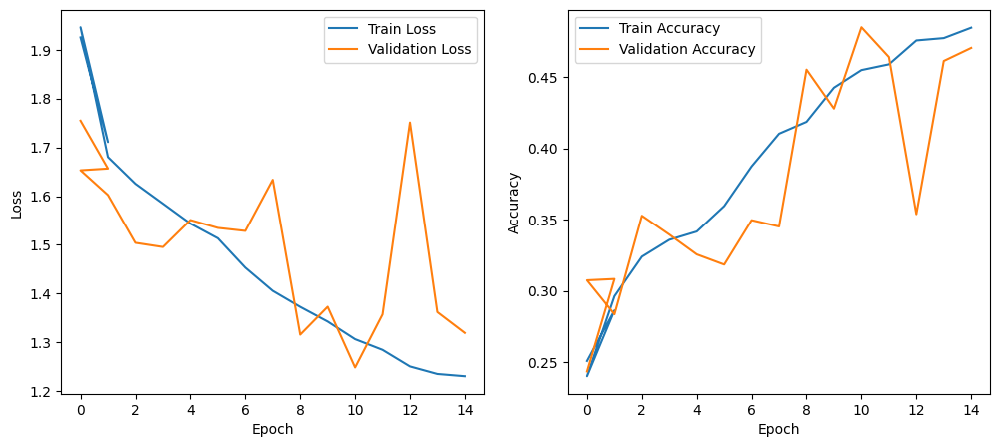

,epoch,train_loss,train_acc,val_loss,val_acc
0,0,1.925309,0.250913,1.754702,0.243540
1,1,1.710886,0.286416,1.656508,0.308411
2,0,1.946201,0.240212,1.653027,0.307495
3,1,1.680078,0.296362,1.602253,0.283672
4,2,1.625377,0.324059,1.504075,0.352758
5,3,1.584570,0.335893,1.495493,0.339564
6,4,1.543622,0.341685,1.550887,0.325637
7,5,1.513339,0.359562,1.534769,0.318490
8,6,1.453206,0.387385,1.528597,0.349643
9,7,1.405624,0.410298,1.633582,0.345245


In [ ]:
plot_train_data(csv="train_log_1_aug_gaussian.csv")

### with more augmentations

In [ ]:
from audiomentations import Compose, AddGaussianNoise, Gain, Shift, HighPassFilter, LowPassFilter

augmentations = Compose([
    AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.01, p=0.4),
    Gain(min_gain_db=-6.0, max_gain_db=6.0, p=0.5),
    Shift(min_shift=-0.3, max_shift=0.3, p=0.5),
    HighPassFilter(min_cutoff_freq=100.0, max_cutoff_freq=300.0, p=0.3),
    LowPassFilter(min_cutoff_freq=4000.0, max_cutoff_freq=6000.0, p=0.3)
])

# Train on Neumann data
train_dataset_neumann = AudioChunkDataset(neumann_df, augment=True, augmentations=augmentations)
train_loader_neumann = DataLoader(train_dataset_neumann, batch_size=32, shuffle=True, num_workers=2)

# Test on AKG data
test_dataset_akg = AudioChunkDataset(akg_df, augment=False)
test_loader_akg = DataLoader(test_dataset_akg, batch_size=32, shuffle=False, num_workers=2)

# Test on iPhone data
test_dataset_iphone = AudioChunkDataset(iphone_df, augment=False)
test_loader_iphone = DataLoader(test_dataset_iphone, batch_size=32, shuffle=False, num_workers=2)

# Instantiate the model (using the model defined in previous cells)
num_classes = len(label_to_class) # Ensure label_to_class is defined from previous steps
model = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

print(f"Training model on Neumann dataset ({len(neumann_df)} samples)")
print(f"Testing on AKG dataset ({len(akg_df)} samples) and iPhone dataset ({len(iphone_df)} samples)")
print(f"Using device: {device}")

# Define criterion for training and evaluation
criterion = nn.CrossEntropyLoss()


# --- Training ---
# Train the model using the Neumann data loader
# Using the 'train_model' function defined previously
train_model(
    model=model,
    train_loader=train_loader_neumann,
    val_loader=test_loader_akg, # Using AKG as a "validation" set during training
    num_epochs=15, # Adjust epochs as needed
    lr=0.001,
    device=device,
    save_path="/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_trained_model_5_aug.pth",
    log_dir="./runs/neumann_train"
)

# --- Testing ---
# Load the best model saved during training (if save_path was used)
try:
    model.load_state_dict(torch.load("/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_trained_model_5_aug.pth"))
    print("Loaded best model for testing.")
except FileNotFoundError:
    print("Model not saved. Testing with the model after the last training epoch.")

model.eval() # Set model to evaluation mode

print("\nEvaluating on AKG test set:")
akg_loss, akg_acc = evaluate(model, test_loader_akg, criterion, device)
print(f"AKG Test Loss: {akg_loss:.4f}, AKG Test Accuracy: {akg_acc:.4f}")

print("\nEvaluating on iPhone test set:")
iphone_loss, iphone_acc = evaluate(model, test_loader_iphone, criterion, device)
print(f"iPhone Test Loss: {iphone_loss:.4f}, iPhone Test Accuracy: {iphone_acc:.4f}")

Training model on Neumann dataset (7943 samples)
Testing on AKG dataset (5457 samples) and iPhone dataset (2188 samples)
Using device: cuda
Training model with  cuda

Epoch 1/15


Training: 100%|██████████| 249/249 [01:07<00:00,  3.70it/s]


Train Loss: 1.9487, Acc: 0.2207 | Val Loss: 1.7704, Acc: 0.2386
Saved model with val acc: 0.2386

Epoch 2/15


Training: 100%|██████████| 249/249 [01:09<00:00,  3.61it/s]


Train Loss: 1.7658, Acc: 0.2556 | Val Loss: 1.7586, Acc: 0.2274

Epoch 3/15


Training: 100%|██████████| 249/249 [01:06<00:00,  3.72it/s]


Train Loss: 1.7636, Acc: 0.2548 | Val Loss: 1.7505, Acc: 0.2283

Epoch 4/15


Training: 100%|██████████| 249/249 [01:06<00:00,  3.76it/s]


Train Loss: 1.7527, Acc: 0.2572 | Val Loss: 1.7554, Acc: 0.2283

Epoch 5/15


Training: 100%|██████████| 249/249 [01:06<00:00,  3.72it/s]


Train Loss: 1.7514, Acc: 0.2570 | Val Loss: 1.7503, Acc: 0.2281

Epoch 6/15


Training: 100%|██████████| 249/249 [01:13<00:00,  3.38it/s]


Train Loss: 1.7479, Acc: 0.2588 | Val Loss: 1.7550, Acc: 0.2322

Epoch 7/15


Training: 100%|██████████| 249/249 [01:08<00:00,  3.61it/s]


Train Loss: 1.7320, Acc: 0.2583 | Val Loss: 2.0335, Acc: 0.2146

Epoch 8/15


Training: 100%|██████████| 249/249 [01:09<00:00,  3.58it/s]


Train Loss: 1.6982, Acc: 0.2731 | Val Loss: 2.0012, Acc: 0.2181

Epoch 9/15


Training: 100%|██████████| 249/249 [01:08<00:00,  3.65it/s]


Train Loss: 1.6593, Acc: 0.2990 | Val Loss: 1.5074, Acc: 0.3487
Saved model with val acc: 0.3487

Epoch 10/15


Training: 100%|██████████| 249/249 [01:11<00:00,  3.50it/s]


Train Loss: 1.6205, Acc: 0.3174 | Val Loss: 2.0622, Acc: 0.2404

Epoch 11/15


Training: 100%|██████████| 249/249 [01:07<00:00,  3.67it/s]


Train Loss: 1.6013, Acc: 0.3259 | Val Loss: 1.4022, Acc: 0.3766
Saved model with val acc: 0.3766

Epoch 12/15


Training: 100%|██████████| 249/249 [01:06<00:00,  3.75it/s]


Train Loss: 1.5570, Acc: 0.3369 | Val Loss: 1.4523, Acc: 0.3621

Epoch 13/15


Training: 100%|██████████| 249/249 [01:08<00:00,  3.65it/s]


Train Loss: 1.5435, Acc: 0.3377 | Val Loss: 1.4428, Acc: 0.3638

Epoch 14/15


Training: 100%|██████████| 249/249 [01:06<00:00,  3.74it/s]


Train Loss: 1.5234, Acc: 0.3470 | Val Loss: 1.4058, Acc: 0.3912
Saved model with val acc: 0.3912

Epoch 15/15


Training:  89%|████████▉ | 221/249 [01:00<00:06,  4.46it/s]

### train on neumann and akg

In [ ]:
# Combine Neumann and AKG data for training
train_df_combined = pd.concat([neumann_df, akg_df], ignore_index=True)

# Split combined data into training and validation sets
# Stratify to maintain class distribution across the combined dataset
train_df, val_df = train_test_split(
    train_df_combined,
    test_size=0.2,  # 20% for validation
    random_state=42,  # for reproducibility
    stratify=train_df_combined['encoded_parent_label']  # Stratify by parent_label
)

# Create datasets and dataloaders for training and validation
# Apply augmentations only to the training set
train_dataset_combined = AudioChunkDataset(train_df, augment=False, augmentations=None) # Use defined augmentations
val_dataset_combined = AudioChunkDataset(val_df, augment=False)

train_loader_combined = DataLoader(train_dataset_combined, batch_size=32, shuffle=True, num_workers=2)
val_loader_combined = DataLoader(val_dataset_combined, batch_size=32, shuffle=False, num_workers=2)

# Test on iPhone data (using the existing test_loader_iphone)
test_dataset_iphone = AudioChunkDataset(iphone_df, augment=False)
test_loader_iphone = DataLoader(test_dataset_iphone, batch_size=32, shuffle=False, num_workers=2)

# Instantiate the model (using the model defined in previous cells)
num_classes = len(label_to_class) # Ensure label_to_class is defined from previous steps
model = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

print(f"Training model on combined Neumann and AKG dataset ({len(train_df_combined)} total samples)")
print(f"Training samples: {len(train_df)}")
print(f"Validation samples: {len(val_df)}")
print(f"Testing on iPhone dataset ({len(iphone_df)} samples)")
print(f"Using device: {device}")

# Define criterion for training and evaluation (using the one defined previously)
criterion = nn.CrossEntropyLoss()


# --- Training ---
# Train the model using the combined train and validation data loaders
train_model(
    model=model,
    train_loader=train_loader_combined,
    val_loader=val_loader_combined, # Use the validation set from the combined data
    num_epochs=15, # Adjust epochs as needed
    lr=0.001,
    device=device,
    save_path="/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_akg_trained_model_no_aug.pth",
    log_dir="./runs/neumann_akg_train" # New log directory for this run
)

# --- Testing ---
# Load the best model saved during training (if save_path was used)
try:
    model.load_state_dict(torch.load("/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_akg_trained_model_no_aug.pth"))
    print("Loaded best model for testing on iPhone.")
except FileNotFoundError:
    print("Model not saved. Testing with the model after the last training epoch.")

model.eval() # Set model to evaluation mode

print("\nEvaluating on iPhone test set:")
iphone_loss, iphone_acc = evaluate(model, test_loader_iphone, criterion, device)
print(f"iPhone Test Loss: {iphone_loss:.4f}, iPhone Test Accuracy: {iphone_acc:.4f}")

Training model on combined Neumann and AKG dataset (13400 total samples)
Training samples: 10720
Validation samples: 2680
Testing on iPhone dataset (2188 samples)
Using device: cuda
Training model with  cuda

Epoch 1/15


Training: 100%|██████████| 335/335 [01:19<00:00,  4.22it/s]


Train Loss: 1.6993, Acc: 0.3110 | Val Loss: 1.3600, Acc: 0.3754
Saved model with val acc: 0.3754

Epoch 2/15


Training: 100%|██████████| 335/335 [01:20<00:00,  4.18it/s]


Train Loss: 1.4018, Acc: 0.3982 | Val Loss: 1.3827, Acc: 0.4142
Saved model with val acc: 0.4142

Epoch 3/15


Training: 100%|██████████| 335/335 [01:19<00:00,  4.23it/s]


Train Loss: 1.3064, Acc: 0.4341 | Val Loss: 1.2692, Acc: 0.4097

Epoch 4/15


Training: 100%|██████████| 335/335 [01:18<00:00,  4.26it/s]


Train Loss: 1.2402, Acc: 0.4626 | Val Loss: 1.1706, Acc: 0.5015
Saved model with val acc: 0.5015

Epoch 5/15


Training: 100%|██████████| 335/335 [01:17<00:00,  4.34it/s]


Train Loss: 1.1729, Acc: 0.4885 | Val Loss: 1.1381, Acc: 0.5090
Saved model with val acc: 0.5090

Epoch 6/15


Training: 100%|██████████| 335/335 [01:18<00:00,  4.28it/s]


Train Loss: 1.1460, Acc: 0.5018 | Val Loss: 1.0469, Acc: 0.5418
Saved model with val acc: 0.5418

Epoch 7/15


Training: 100%|██████████| 335/335 [01:16<00:00,  4.35it/s]


Train Loss: 1.0854, Acc: 0.5276 | Val Loss: 0.9235, Acc: 0.6011
Saved model with val acc: 0.6011

Epoch 8/15


Training: 100%|██████████| 335/335 [01:17<00:00,  4.32it/s]


Train Loss: 1.0437, Acc: 0.5445 | Val Loss: 0.9281, Acc: 0.5910

Epoch 9/15


Training: 100%|██████████| 335/335 [01:16<00:00,  4.38it/s]


Train Loss: 1.0256, Acc: 0.5584 | Val Loss: 0.8862, Acc: 0.6037
Saved model with val acc: 0.6037

Epoch 10/15


Training: 100%|██████████| 335/335 [01:15<00:00,  4.41it/s]


Train Loss: 0.9831, Acc: 0.5684 | Val Loss: 0.8335, Acc: 0.6343
Saved model with val acc: 0.6343

Epoch 11/15


Training: 100%|██████████| 335/335 [01:15<00:00,  4.45it/s]


Train Loss: 0.9501, Acc: 0.5759 | Val Loss: 0.8962, Acc: 0.6127

Epoch 12/15


Training: 100%|██████████| 335/335 [01:15<00:00,  4.47it/s]


Train Loss: 0.9270, Acc: 0.5918 | Val Loss: 0.8249, Acc: 0.6560
Saved model with val acc: 0.6560

Epoch 13/15


Training: 100%|██████████| 335/335 [01:16<00:00,  4.39it/s]


Train Loss: 0.9076, Acc: 0.6009 | Val Loss: 0.7783, Acc: 0.6750
Saved model with val acc: 0.6750

Epoch 14/15


Training: 100%|██████████| 335/335 [01:16<00:00,  4.36it/s]


Train Loss: 0.8764, Acc: 0.6092 | Val Loss: 0.7638, Acc: 0.6825
Saved model with val acc: 0.6825

Epoch 15/15


Training: 100%|██████████| 335/335 [01:18<00:00,  4.27it/s]


Train Loss: 0.8627, Acc: 0.6207 | Val Loss: 0.7212, Acc: 0.7034
Saved model with val acc: 0.7034

Training complete.
Loaded best model for testing on iPhone.

Evaluating on iPhone test set:
iPhone Test Loss: 5.1972, iPhone Test Accuracy: 0.4063


We see its not generalising well to the iphone set. Compared to when we just run on the neumann mic we see the accuracy actually drop

Evaluating on iPhone test set:
iPhone Test Loss: 5.1972, iPhone Test Accuracy: 0.4063


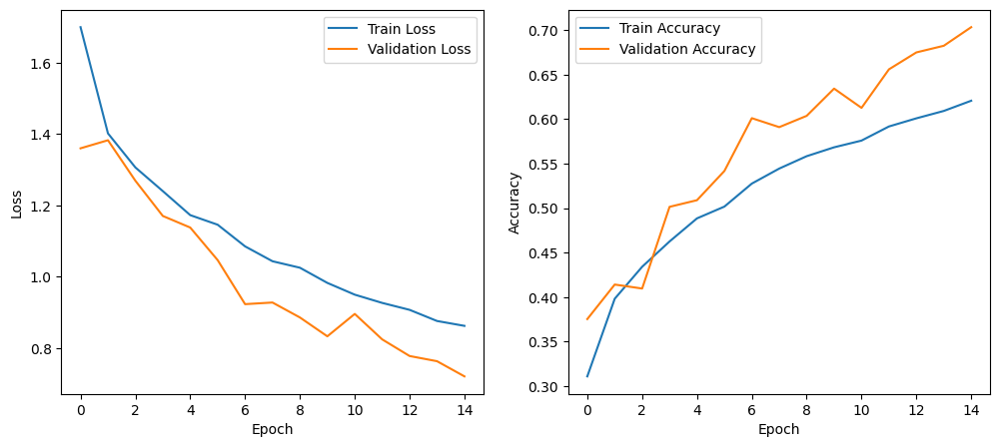

,epoch,train_loss,train_acc,val_loss,val_acc
0,0,1.699345,0.311007,1.360033,0.375373
1,1,1.401799,0.398228,1.382652,0.414179
2,2,1.306436,0.434142,1.269178,0.409701
3,3,1.240166,0.462593,1.170565,0.501493
4,4,1.172904,0.488526,1.138111,0.508955
5,5,1.146047,0.501772,1.046920,0.541791
6,6,1.085390,0.527612,0.923536,0.601119
7,7,1.043714,0.544496,0.928105,0.591045
8,8,1.025559,0.558396,0.886241,0.603731
9,9,0.983090,0.568377,0.833477,0.634328


In [ ]:
plot_train_data(csv="train_log_1_aug_gaussian.csv")

### train on neumann and iphone

In [ ]:
# Combine Neumann and iPhone data for training
train_df_combined = pd.concat([neumann_df, iphone_df], ignore_index=True)

# Split combined data into training and validation sets
# Stratify to maintain class distribution across the combined dataset
train_df, val_df = train_test_split(
    train_df_combined,
    test_size=0.2,  # 20% for validation
    random_state=42,  # for reproducibility
    stratify=train_df_combined['encoded_parent_label']  # Stratify by parent_label
)

# Create datasets and dataloaders for training and validation
# Apply augmentations only to the training set
train_dataset_combined = AudioChunkDataset(train_df, augment=False, augmentations=None) # Use defined augmentations
val_dataset_combined = AudioChunkDataset(val_df, augment=False)

train_loader_combined = DataLoader(train_dataset_combined, batch_size=32, shuffle=True, num_workers=2)
val_loader_combined = DataLoader(val_dataset_combined, batch_size=32, shuffle=False, num_workers=2)

# Test on AKG data (using the existing test_loader_akg)
test_dataset_akg = AudioChunkDataset(akg_df, augment=False)
test_loader_akg = DataLoader(test_dataset_akg, batch_size=32, shuffle=False, num_workers=2)

# Instantiate the model (using the model defined in previous cells)
num_classes = len(label_to_class) # Ensure label_to_class is defined from previous steps
model = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

print(f"Training model on combined Neumann and iPhone dataset ({len(train_df_combined)} total samples)")
print(f"Training samples: {len(train_df)}")
print(f"Validation samples: {len(val_df)}")
print(f"Testing on AKG dataset ({len(akg_df)} samples)")
print(f"Using device: {device}")

# Define criterion for training and evaluation (using the one defined previously)
criterion = nn.CrossEntropyLoss()


# --- Training ---
# Train the model using the combined train and validation data loaders
train_model(
    model=model,
    train_loader=train_loader_combined,
    val_loader=val_loader_combined, # Use the validation set from the combined data
    num_epochs=15, # Adjust epochs as needed
    lr=0.001,
    device=device,
    save_path="/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_iphone_trained_model_no_aug.pth",
    log_dir="./runs/neumann_iphone_train" # New log directory for this run
)

# --- Testing ---
# Load the best model saved during training (if save_path was used)
try:
    model.load_state_dict(torch.load("/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_iphone_trained_model_no_aug.pth"))
    print("Loaded best model for testing on AKG.")
except FileNotFoundError:
    print("Model not saved. Testing with the model after the last training epoch.")

model.eval() # Set model to evaluation mode

print("\nEvaluating on AKG test set:")
akg_loss, akg_acc = evaluate(model, test_loader_akg, criterion, device)
print(f"AKG Test Loss: {akg_loss:.4f}, AKG Test Accuracy: {akg_acc:.4f}")

Training model on combined Neumann and iPhone dataset (10131 total samples)
Training samples: 8104
Validation samples: 2027
Testing on AKG dataset (5457 samples)
Using device: cuda
Training model with  cuda

Epoch 1/15


Training: 100%|██████████| 254/254 [01:00<00:00,  4.18it/s]


Train Loss: 1.7987, Acc: 0.3227 | Val Loss: 1.4652, Acc: 0.4415
Saved model with val acc: 0.4415

Epoch 2/15


Training: 100%|██████████| 254/254 [01:00<00:00,  4.23it/s]


Train Loss: 1.4944, Acc: 0.3973 | Val Loss: 1.4316, Acc: 0.3878

Epoch 3/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.24it/s]


Train Loss: 1.4323, Acc: 0.4130 | Val Loss: 1.3391, Acc: 0.4642
Saved model with val acc: 0.4642

Epoch 4/15


Training: 100%|██████████| 254/254 [01:00<00:00,  4.17it/s]


Train Loss: 1.3654, Acc: 0.4307 | Val Loss: 1.2422, Acc: 0.4716
Saved model with val acc: 0.4716

Epoch 5/15


Training: 100%|██████████| 254/254 [01:05<00:00,  3.88it/s]


Train Loss: 1.3357, Acc: 0.4379 | Val Loss: 1.3737, Acc: 0.4376

Epoch 6/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.27it/s]


Train Loss: 1.2938, Acc: 0.4684 | Val Loss: 1.1958, Acc: 0.5091
Saved model with val acc: 0.5091

Epoch 7/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.28it/s]


Train Loss: 1.2389, Acc: 0.4864 | Val Loss: 1.1454, Acc: 0.5195
Saved model with val acc: 0.5195

Epoch 8/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.26it/s]


Train Loss: 1.2033, Acc: 0.4891 | Val Loss: 1.0578, Acc: 0.5516
Saved model with val acc: 0.5516

Epoch 9/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.25it/s]


Train Loss: 1.1668, Acc: 0.5027 | Val Loss: 1.0546, Acc: 0.5738
Saved model with val acc: 0.5738

Epoch 10/15


Training: 100%|██████████| 254/254 [01:04<00:00,  3.93it/s]


Train Loss: 1.1272, Acc: 0.5297 | Val Loss: 1.0210, Acc: 0.5836
Saved model with val acc: 0.5836

Epoch 11/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.24it/s]


Train Loss: 1.0952, Acc: 0.5399 | Val Loss: 1.1271, Acc: 0.5604

Epoch 12/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.24it/s]


Train Loss: 1.0617, Acc: 0.5516 | Val Loss: 0.9862, Acc: 0.5989
Saved model with val acc: 0.5989

Epoch 13/15


Training: 100%|██████████| 254/254 [01:00<00:00,  4.22it/s]


Train Loss: 1.0168, Acc: 0.5710 | Val Loss: 0.9750, Acc: 0.5925

Epoch 14/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.28it/s]


Train Loss: 1.0070, Acc: 0.5744 | Val Loss: 0.8901, Acc: 0.6334
Saved model with val acc: 0.6334

Epoch 15/15


Training: 100%|██████████| 254/254 [00:59<00:00,  4.25it/s]


Train Loss: 0.9752, Acc: 0.5854 | Val Loss: 0.8764, Acc: 0.6330

Training complete.
Loaded best model for testing on AKG.

Evaluating on AKG test set:
AKG Test Loss: 1.7144, AKG Test Accuracy: 0.4402


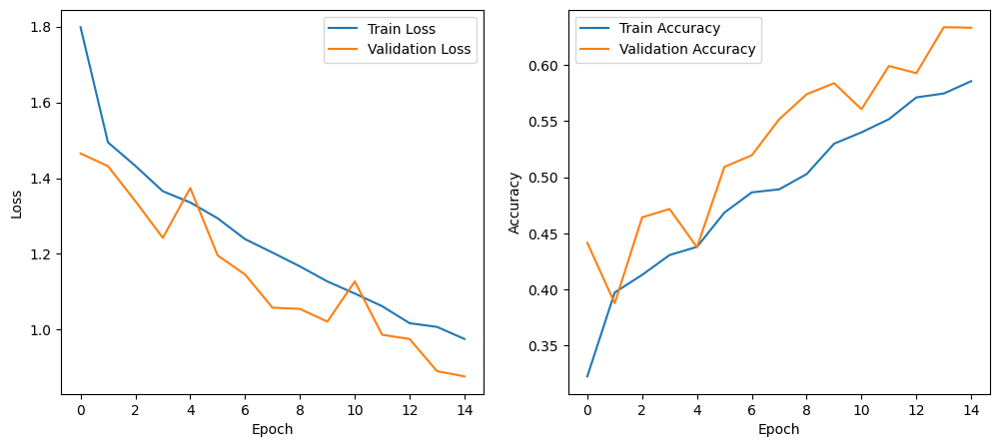

,epoch,train_loss,train_acc,val_loss,val_acc
0,0,1.798652,0.322680,1.465184,0.441539
1,1,1.494410,0.397335,1.431583,0.387765
2,2,1.432294,0.413006,1.339073,0.464233
3,3,1.365367,0.430652,1.242221,0.471633
4,4,1.335692,0.437932,1.373750,0.437593
5,5,1.293794,0.468411,1.195770,0.509127
6,6,1.238863,0.486426,1.145383,0.519487
7,7,1.203325,0.489141,1.057755,0.551554
8,8,1.166827,0.502715,1.054586,0.573754
9,9,1.127161,0.529738,1.020993,0.583621


In [ ]:
plot_train_data(csv="train_log_neumann_iphone_trained_model_no_aug.csv")

### Test pregenerate_augmented_mels

In [ ]:
# Define an output directory for the pre-generated mels
pregenerated_output_dir = "/content/pregenerated_mels_test"

# Define augmentations (you can use the default or define your own)
# Using the default Gaussian noise for this test
# from audiomentations import Compose, AddGaussianNoise
# test_augmentations = Compose([
#     AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=1.0),
# ])

# Call the pregenerate function
# This will save original and 1 augmented mel spec per chunk in chunked_df
pregenerated_df_test = pregenerate_augmented_mels(
    df=iphone_df,
    output_base_dir=pregenerated_output_dir,
    num_augmentations_per_sample=1, # Generate 1 augmented version per sample
    augmentations=None, # Use default Gaussian noise augmentation
    seed=42
)

In [ ]:



print("\nPregenerated metadata DataFrame head:")
display(pregenerated_df_test.head())

print(f"\nNumber of rows in the pregenerated metadata: {len(pregenerated_df_test)}")
print(f"Number of original chunks in chunked_df: {len(iphone_df)}")
print(f"Expected number of pregenerated files (original + 1 aug per original): {len(iphone_df) * 2}")

# Verify some files were created (optional)
import glob
generated_files = glob.glob(os.path.join(pregenerated_output_dir, "*.pt"))
print(f"\nNumber of .pt files created in {pregenerated_output_dir}: {len(generated_files)}")


Pregenerated metadata DataFrame head:


,id_x,instrument,note,octave,dynamics,recorded_at,location,player,bow_velocity,bridge_position,...,original_filename,freesound_id,sound_id,goodsound_id,parent_label,encoded_parent_label,chunk_filename,parent_filename,pregenerated_mel_path,augmentation_type
0,3934,violin,G,3.0,None,2014-10-17 14:00:00.000000,upf studio,laia,None,None,...,IPhone render 001.wav,NaN,3934,NaN,good-sound,5,/content/dataset-processed-iphone/violin_laia_...,/content/dataset/violin_laia_improvement_recor...,/content/pregenerated_mels_test/violin_laia_im...,original
1,3934,violin,G,3.0,None,2014-10-17 14:00:00.000000,upf studio,laia,None,None,...,IPhone render 001.wav,NaN,3934,NaN,good-sound,5,/content/dataset-processed-iphone/violin_laia_...,/content/dataset/violin_laia_improvement_recor...,/content/pregenerated_mels_test/violin_laia_im...,augmentation_1
2,3934,violin,G,3.0,None,2014-10-17 14:00:00.000000,upf studio,laia,None,None,...,IPhone render 001.wav,NaN,3934,NaN,good-sound,5,/content/dataset-processed-iphone/violin_laia_...,/content/dataset/violin_laia_improvement_recor...,/content/pregenerated_mels_test/violin_laia_im...,original
3,3934,violin,G,3.0,None,2014-10-17 14:00:00.000000,upf studio,laia,None,None,...,IPhone render 001.wav,NaN,3934,NaN,good-sound,5,/content/dataset-processed-iphone/violin_laia_...,/content/dataset/violin_laia_improvement_recor...,/content/pregenerated_mels_test/violin_laia_im...,augmentation_1
4,3934,violin,G,3.0,None,2014-10-17 14:00:00.000000,upf studio,laia,None,None,...,IPhone render 001.wav,NaN,3934,NaN,good-sound,5,/content/dataset-processed-iphone/violin_laia_...,/content/dataset/violin_laia_improvement_recor...,/content/pregenerated_mels_test/violin_laia_im...,original



Number of rows in the pregenerated metadata: 4376
Number of original chunks in chunked_df: 2188
Expected number of pregenerated files (original + 1 aug per original): 4376

Number of .pt files created in /content/pregenerated_mels_test: 4376


### Train and Evaluate with Pregenerated Data (Neumann Train, AKG/iPhone Test)

In [ ]:
# --- 1. Pre-generate Mel Spectrograms for Training Data (Neumann) ---
pregenerated_neumann_dir = "/content/pregenerated_mels_neumann"

# Define augmentations for training data
# You can customize this Compose based on the augmentations you want to pre-generate
train_augmentations = Compose([
    AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.5),
    Gain(min_gain_db=-6.0, max_gain_db=6.0, p=0.4),
    Shift(min_shift=-0.3, max_shift=0.3, p=0.3),
])

print("Pregenerating Neumann training data with augmentations...")
pregenerated_neumann_df = pregenerate_augmented_mels(
    df=neumann_df, # Use the Neumann DataFrame
    output_base_dir=pregenerated_neumann_dir,
    num_augmentations_per_sample=2, # Example: Generate 2 augmented versions per sample
    augmentations=train_augmentations,
    seed=42,
    disable_augmentations=False # Enable augmentations for training data
)

print(f"Pregenerated Neumann data shape: {pregenerated_neumann_df.shape}")
print("\nPregenerated Neumann data distribution:")
display(pregenerated_neumann_df['parent_label'].value_counts())
print("\nAugmentation types distribution in pregenerated Neumann data:")
display(pregenerated_neumann_df['augmentation_type'].value_counts())


# --- 2. Split Pregenerated Training Data for Train/Validation ---
# Split the pregenerated Neumann data into training and validation sets
train_pregenerated_df, val_pregenerated_df = train_test_split(
    pregenerated_neumann_df,
    test_size=0.2,  # 20% for validation
    random_state=42, # for reproducibility
    stratify=pregenerated_neumann_df['encoded_parent_label'] # Stratify by parent_label
)

print(f"\nPregenerated training samples: {len(train_pregenerated_df)}")
print(f"Pregenerated validation samples: {len(val_pregenerated_df)}")


# --- 3. Create Pregenerated Datasets and DataLoaders ---
train_dataset_pregenerated = PregeneratedMelDataset(train_pregenerated_df)
val_dataset_pregenerated = PregeneratedMelDataset(val_pregenerated_df)

batch_size = 32 # You can adjust this
train_loader_pregenerated = DataLoader(train_dataset_pregenerated, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader_pregenerated = DataLoader(val_dataset_pregenerated, batch_size=batch_size, shuffle=False, num_workers=2)

print(f"\nPregenerated Train DataLoader created with {len(train_loader_pregenerated)} batches.")
print(f"Pregenerated Validation DataLoader created with {len(val_loader_pregenerated)} batches.")


# --- 4. Instantiate the Model ---
num_classes = len(label_to_class) # Use the label_to_class from earlier steps
model_pregenerated = SimpleCNN(num_classes=num_classes)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_pregenerated.to(device)

print(f"\nModel instantiated for pregenerated data training. Using device: {device}")


# --- 5. Train the Model using Pregenerated Data ---
# Define save path for the pregenerated model
pregenerated_model_save_path = "/content/drive/My Drive/models/violin_spectrogram_classifier/neumann_pregenerated_model.pth"
pregenerated_log_dir = "./runs/neumann_pregenerated_train"

print("\nStarting training with pregenerated data...")
train_model_pregenerated(
    model=model_pregenerated,
    train_loader=train_loader_pregenerated,
    val_loader=val_loader_pregenerated,
    num_epochs=15, # Adjust epochs as needed
    lr=0.001,
    device=device,
    save_path=pregenerated_model_save_path,
    log_dir=pregenerated_log_dir
)


# --- 6. Pre-generate Mel Spectrograms for Test Data (AKG and iPhone) ---
# We pre-generate test data without augmentation
pregenerated_akg_dir = "/content/pregenerated_mels_akg_test"
pregenerated_iphone_dir = "/content/pregenerated_mels_iphone_test"

print("\nPregenerating AKG test data (no augmentations)...")
pregenerated_akg_df = pregenerate_augmented_mels(
    df=akg_df, # Use the AKG DataFrame
    output_base_dir=pregenerated_akg_dir,
    num_augmentations_per_sample=0, # No augmentations for test data
    augmentations=None, # Augmentations object is ignored when disable_augmentations is True
    seed=42,
    disable_augmentations=True # Disable augmentations for test data
)

print(f"Pregenerated AKG test data shape: {pregenerated_akg_df.shape}")


print("\nPregenerating iPhone test data (no augmentations)...")
pregenerated_iphone_df = pregenerate_augmented_mels(
    df=iphone_df, # Use the iPhone DataFrame
    output_base_dir=pregenerated_iphone_dir,
    num_augmentations_per_sample=0, # No augmentations for test data
    augmentations=None, # Augmentations object is ignored when disable_augmentations is True
    seed=42,
    disable_augmentations=True # Disable augmentations for test data
)
print(f"Pregenerated iPhone test data shape: {pregenerated_iphone_df.shape}")


# --- 7. Create Pregenerated Test Datasets and DataLoaders ---
test_dataset_akg_pregenerated = PregeneratedMelDataset(pregenerated_akg_df)
test_loader_akg_pregenerated = DataLoader(test_dataset_akg_pregenerated, batch_size=batch_size, shuffle=False, num_workers=2)

test_dataset_iphone_pregenerated = PregeneratedMelDataset(pregenerated_iphone_df)
test_loader_iphone_pregenerated = DataLoader(test_dataset_iphone_pregenerated, batch_size=batch_size, shuffle=False, num_workers=2)

print(f"\nPregenerated AKG Test DataLoader created with {len(test_loader_akg_pregenerated)} batches.")
print(f"Pregenerated iPhone Test DataLoader created with {len(test_loader_iphone_pregenerated)} batches.")


# --- 8. Load the Best Trained Model ---
# Instantiate a new model and load the state dict from the saved best model
model_eval = SimpleCNN(num_classes=num_classes)
model_eval.to(device) # Move to the same device as training

try:
    model_eval.load_state_dict(torch.load(pregenerated_model_save_path))
    print(f"\nLoaded best model from {pregenerated_model_save_path} for testing.")
except FileNotFoundError:
    print(f"\nWarning: Model file not found at {pregenerated_model_save_path}. Evaluating with the model state after the last training epoch.")
    model_eval.load_state_dict(model_pregenerated.state_dict()) # Load the state from the model trained in this run


# --- 9. Evaluate the Model on Test Sets ---
criterion_eval = nn.CrossEntropyLoss() # Criterion for evaluation

print("\nEvaluating on Pregenerated AKG test set:")
akg_loss_pregenerated, akg_acc_pregenerated = evaluate_pregenerated(model_eval, test_loader_akg_pregenerated, criterion_eval, device)
print(f"AKG Test Loss (Pregenerated): {akg_loss_pregenerated:.4f}, AKG Test Accuracy (Pregenerated): {akg_acc_pregenerated:.4f}")

print("\nEvaluating on Pregenerated iPhone test set:")
iphone_loss_pregenerated, iphone_acc_pregenerated = evaluate_pregenerated(model_eval, test_loader_iphone_pregenerated, criterion_eval, device)
print(f"iPhone Test Loss (Pregenerated): {iphone_loss_pregenerated:.4f}, iPhone Test Accuracy (Pregenerated): {iphone_acc_pregenerated:.4f}")

Pregenerating Neumann training data with augmentations...


Pregenerating augmented mels: 100%|██████████| 7943/7943 [02:39<00:00, 49.91it/s]


Pregenerated Neumann data shape: (23829, 38)

Pregenerated Neumann data distribution:


,count
parent_label,
bad-dynamic-stability,5964
bad-timbre-richness,4119
bad-pitch-stability,3915
good-sound,3390
bad-attack-clarity,3243
bad-timbre-stability,3198



Augmentation types distribution in pregenerated Neumann data:


,count
augmentation_type,
original,7943
augmentation_1,7943
augmentation_2,7943



Pregenerated training samples: 19063
Pregenerated validation samples: 4766

Pregenerated Train DataLoader created with 596 batches.
Pregenerated Validation DataLoader created with 149 batches.

Model instantiated for pregenerated data training. Using device: cuda

Starting training with pregenerated data...
Training pregenerated model with  cuda

Epoch 1/15


Training: 100%|██████████| 596/596 [00:18<00:00, 33.01it/s]


Train Loss: 1.8163, Acc: 0.2698 | Val Loss: 1.6896, Acc: 0.3019
Saved model with val acc: 0.3019

Epoch 2/15


Training: 100%|██████████| 596/596 [00:16<00:00, 35.79it/s]


Train Loss: 1.6015, Acc: 0.3292 | Val Loss: 1.4799, Acc: 0.3888
Saved model with val acc: 0.3888

Epoch 3/15


Training: 100%|██████████| 596/596 [00:17<00:00, 34.25it/s]


Train Loss: 1.4502, Acc: 0.3904 | Val Loss: 1.3720, Acc: 0.4373
Saved model with val acc: 0.4373

Epoch 4/15


Training: 100%|██████████| 596/596 [00:16<00:00, 35.58it/s]


Train Loss: 1.3514, Acc: 0.4258 | Val Loss: 1.1637, Acc: 0.5277
Saved model with val acc: 0.5277

Epoch 5/15


Training: 100%|██████████| 596/596 [00:17<00:00, 34.81it/s]


Train Loss: 1.2699, Acc: 0.4613 | Val Loss: 1.1027, Acc: 0.5422
Saved model with val acc: 0.5422

Epoch 6/15


Training: 100%|██████████| 596/596 [00:16<00:00, 35.15it/s]


Train Loss: 1.2190, Acc: 0.4866 | Val Loss: 1.1042, Acc: 0.5445
Saved model with val acc: 0.5445

Epoch 7/15


Training: 100%|██████████| 596/596 [00:16<00:00, 35.11it/s]


Train Loss: 1.1662, Acc: 0.5005 | Val Loss: 1.0673, Acc: 0.5590
Saved model with val acc: 0.5590

Epoch 8/15


Training: 100%|██████████| 596/596 [00:17<00:00, 34.61it/s]


Train Loss: 1.1137, Acc: 0.5317 | Val Loss: 0.9279, Acc: 0.6370
Saved model with val acc: 0.6370

Epoch 9/15


Training: 100%|██████████| 596/596 [00:17<00:00, 34.79it/s]


Train Loss: 1.0655, Acc: 0.5505 | Val Loss: 0.9230, Acc: 0.6200

Epoch 10/15


Training: 100%|██████████| 596/596 [00:17<00:00, 33.82it/s]


Train Loss: 1.0121, Acc: 0.5723 | Val Loss: 0.8391, Acc: 0.6588
Saved model with val acc: 0.6588

Epoch 11/15


Training: 100%|██████████| 596/596 [00:16<00:00, 35.24it/s]


Train Loss: 0.9771, Acc: 0.5900 | Val Loss: 0.8114, Acc: 0.6807
Saved model with val acc: 0.6807

Epoch 12/15


Training: 100%|██████████| 596/596 [00:18<00:00, 32.16it/s]


Train Loss: 0.9335, Acc: 0.6118 | Val Loss: 0.8000, Acc: 0.6804

Epoch 13/15


Training: 100%|██████████| 596/596 [00:17<00:00, 35.03it/s]


Train Loss: 0.9065, Acc: 0.6181 | Val Loss: 0.7963, Acc: 0.6815
Saved model with val acc: 0.6815

Epoch 14/15


Training: 100%|██████████| 596/596 [00:18<00:00, 32.48it/s]


Train Loss: 0.8672, Acc: 0.6394 | Val Loss: 0.7837, Acc: 0.6949
Saved model with val acc: 0.6949

Epoch 15/15


Training: 100%|██████████| 596/596 [00:17<00:00, 34.72it/s]


Train Loss: 0.8416, Acc: 0.6481 | Val Loss: 0.7562, Acc: 0.6991
Saved model with val acc: 0.6991

Training complete.

Pregenerating AKG test data (no augmentations)...


Pregenerating augmented mels: 100%|██████████| 5457/5457 [00:56<00:00, 96.02it/s]


Pregenerated AKG test data shape: (5457, 38)

Pregenerating iPhone test data (no augmentations)...


Pregenerating augmented mels: 100%|██████████| 2188/2188 [00:23<00:00, 92.78it/s]


Pregenerated iPhone test data shape: (2188, 38)

Pregenerated AKG Test DataLoader created with 171 batches.
Pregenerated iPhone Test DataLoader created with 69 batches.

Loaded best model from /content/drive/My Drive/models/violin_spectrogram_classifier/neumann_pregenerated_model.pth for testing.

Evaluating on Pregenerated AKG test set:
AKG Test Loss (Pregenerated): 2.2057, AKG Test Accuracy (Pregenerated): 0.4477

Evaluating on Pregenerated iPhone test set:
iPhone Test Loss (Pregenerated): 4.3261, iPhone Test Accuracy (Pregenerated): 0.3985


In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

todo
---
write the tensorboard runs to drive, so i can compare over sessions.
we should also log extra information such as:
- the microphones trained on
- the test set accuracy and loss scores
- the augmentations used (if any)